In [1]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sns

C:\Users\kerem\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
df_dynamic = pd.read_csv("06.2.w_e_050321_fcdDynamicData.csv")
df_static = pd.read_csv("06.2.w_e_fcdStaticData.csv")

In [3]:
#discoveryTime: verinin geldiği dakika
#segmentId: yol segmentlere bölünüyor, yol segmentleri, segmentlere verilen idler, 
#travelTime: segmentID si için seyehat süresi, travelTime kolonunun birimi millisecond.
#coverage: gelen verinin kaç cihazdan geldi +10 -> 10 
df_dynamic

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-05 00:00:00,131016,1576,10
1,2021-03-05 00:00:00,134879,1311,10
2,2021-03-05 00:00:00,135146,1539,10
3,2021-03-05 00:00:00,182928,1769,10
4,2021-03-05 00:00:00,182929,1769,10
...,...,...,...,...
88401,2021-03-05 23:55:00,7425668,3062,10
88402,2021-03-05 23:55:00,7425669,3062,10
88403,2021-03-05 23:55:00,7452950,3480,10
88404,2021-03-05 23:55:00,7452951,2036,10


In [4]:
#segmentId: .........
#lengthmm: segmentin uzunluğu, lengthmm kolonunun birimi millimeter.
#speedLimitKph: segmentteki hız limiti
df_static

,segmentId,lengthmm,speedLimitKph
0,678443,36117,50
1,678442,36117,50
2,678441,36117,50
3,678400,26236,50
4,678399,26236,50
...,...,...,...
302,5855955,45003,70
303,5855954,45003,70
304,5855953,45003,70
305,5855963,38866,70


In [5]:
def dataframeInformations(df):
  totalEntryList=[]
  totalMissingValueList=[]
  missingValRateList=[]
  dataTypeList=[]
  uniqueValuesList=[]
  totalUniqueValList=[]
  variableNameList=[]
  
  for element in df.columns:
    missingValRate=round((df[element].isna().sum()/len(df[element]))*100,2) #to show correct decimal and float part of number.
    totalEntryList.append(len(df[element]))
    totalMissingValueList.append(df[element].isna().sum())
    missingValRateList.append(missingValRate)
    dataTypeList.append(df[element].dtype)
    uniqueValuesList.append(list(df[element].unique()))
    totalUniqueValList.append(len(df[element].unique()))
    variableNameList.append(element)
  #create a dataframe to show all informations together
  dataInfoDf=pd.DataFrame({'Variable':variableNameList,'#_Total_Entry':totalEntryList,\
                           '#_Missing_Value':totalMissingValueList,'%_Missing_Value':missingValRateList,\
                           'Data_Type':dataTypeList,'Unique_Values':uniqueValuesList,\
                           '#_Uniques_Values':totalUniqueValList})
  return dataInfoDf.sort_values(by="Variable")

In [6]:
dataInfo=dataframeInformations(df_dynamic)
variableList=[element for element in dataInfo['Variable'] ]
dataInfo=dataInfo.set_index('Variable')
dataInfo

,#_Total_Entry,#_Missing_Value,%_Missing_Value,Data_Type,Unique_Values,#_Uniques_Values
Variable,,,,,,
coverage,88406,0,0.0,int64,"[10, 9, 6, 5, 4, 3, 2, 1, 7, 8]",10
discoveryTime,88406,0,0.0,object,"[2021-03-05 00:00:00, 2021-03-05 00:05:00, 202...",288
segmentId,88406,0,0.0,int64,"[131016, 134879, 135146, 182928, 182929, 18293...",307
travelTime,88406,0,0.0,int64,"[1576, 1311, 1539, 1769, 1351, 1127, 2390, 151...",10077


In [7]:
dataInfo=dataframeInformations(df_static)
variableList=[element for element in dataInfo['Variable'] ]
dataInfo=dataInfo.set_index('Variable')
dataInfo

,#_Total_Entry,#_Missing_Value,%_Missing_Value,Data_Type,Unique_Values,#_Uniques_Values
Variable,,,,,,
lengthmm,307,0,0.0,int64,"[36117, 26236, 28279, 48346, 15653, 33773, 354...",122
segmentId,307,0,0.0,int64,"[678443, 678442, 678441, 678400, 678399, 74529...",307
speedLimitKph,307,0,0.0,int64,"[50, 70]",2


In [8]:
set(df_static['segmentId']) == set(df_dynamic['segmentId'])

True

In [9]:
df_new_dynamic1 = pd.read_csv("06.2.w_e_030321_fcdDynamicData.csv")
df_new_dynamic2 = pd.read_csv("06.2.w_e_040321_fcdDynamicData.csv")
df_new_dynamic3 = pd.read_csv("06.2.w_e_150321_fcdDynamicData.csv")

In [10]:
df_dynamic

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-05 00:00:00,131016,1576,10
1,2021-03-05 00:00:00,134879,1311,10
2,2021-03-05 00:00:00,135146,1539,10
3,2021-03-05 00:00:00,182928,1769,10
4,2021-03-05 00:00:00,182929,1769,10
...,...,...,...,...
88401,2021-03-05 23:55:00,7425668,3062,10
88402,2021-03-05 23:55:00,7425669,3062,10
88403,2021-03-05 23:55:00,7452950,3480,10
88404,2021-03-05 23:55:00,7452951,2036,10


In [11]:
df_new_dynamic1

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-03 00:00:00,131016,1576,10
1,2021-03-03 00:00:00,134879,1311,10
2,2021-03-03 00:00:00,135146,1539,10
3,2021-03-03 00:00:00,182928,1769,10
4,2021-03-03 00:00:00,182929,1769,10
...,...,...,...,...
87797,2021-03-03 23:55:00,7425668,3062,10
87798,2021-03-03 23:55:00,7425669,3062,10
87799,2021-03-03 23:55:00,7452950,3480,10
87800,2021-03-03 23:55:00,7452951,2036,10


In [12]:
df_new_dynamic2

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-04 00:00:00,131016,1576,10
1,2021-03-04 00:00:00,134879,1311,10
2,2021-03-04 00:00:00,135146,1539,10
3,2021-03-04 00:00:00,182928,1769,10
4,2021-03-04 00:00:00,182929,1769,10
...,...,...,...,...
87183,2021-03-04 23:55:00,7425668,3062,10
87184,2021-03-04 23:55:00,7425669,3062,10
87185,2021-03-04 23:55:00,7452950,3480,10
87186,2021-03-04 23:55:00,7452951,2036,10


In [13]:
df_new_dynamic3

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-15 00:00:00,131016,1576,10
1,2021-03-15 00:00:00,134879,1311,10
2,2021-03-15 00:00:00,135146,1539,10
3,2021-03-15 00:00:00,182928,1769,10
4,2021-03-15 00:00:00,182929,1769,10
...,...,...,...,...
82578,2021-03-15 23:56:00,7425668,3062,10
82579,2021-03-15 23:56:00,7425669,3062,10
82580,2021-03-15 23:56:00,7452950,3480,10
82581,2021-03-15 23:56:00,7452951,2036,10


In [14]:
df_test = df_new_dynamic3
df_dynamic = df_dynamic.append(df_new_dynamic1, ignore_index=True).append(df_new_dynamic2, ignore_index=True)
df_dynamic

,discoveryTime,segmentId,travelTime,coverage
0,2021-03-05 00:00:00,131016,1576,10
1,2021-03-05 00:00:00,134879,1311,10
2,2021-03-05 00:00:00,135146,1539,10
3,2021-03-05 00:00:00,182928,1769,10
4,2021-03-05 00:00:00,182929,1769,10
...,...,...,...,...
263391,2021-03-04 23:55:00,7425668,3062,10
263392,2021-03-04 23:55:00,7425669,3062,10
263393,2021-03-04 23:55:00,7452950,3480,10
263394,2021-03-04 23:55:00,7452951,2036,10


In [15]:
df_conc = pd.merge(df_static, df_dynamic, left_on='segmentId', right_on='segmentId', how='left')
df_test = pd.merge(df_static, df_test, left_on='segmentId', right_on='segmentId', how='left')

In [16]:
df_conc[df_conc.duplicated()].any()

segmentId        True
lengthmm         True
speedLimitKph    True
discoveryTime    True
travelTime       True
coverage         True
dtype: bool

In [17]:
df_conc['discoveryTime'] = pd.to_datetime(df_conc['discoveryTime'], errors = 'coerce')
df_conc['discoveryTime'] = pd.to_datetime(df_conc['discoveryTime'], errors = 'coerce')
#test
df_test['discoveryTime'] = pd.to_datetime(df_test['discoveryTime'], errors = 'coerce')
df_test['discoveryTime'] = pd.to_datetime(df_test['discoveryTime'], errors = 'coerce')

In [18]:
# mm/ms = m/s spped
df_conc['speed'] = df_conc['lengthmm'] / df_conc['travelTime']
df_conc['speed'] = df_conc['speed']*(60*60)/1000
df_conc
#test
# mm/ms = m/s spped
df_test['speed'] = df_test['lengthmm'] / df_test['travelTime']
df_test['speed'] = df_test['speed']*(60*60)/1000
df_test

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed
0,678443,36117,50,2021-03-15 00:00:00,2600,10,50.008154
1,678443,36117,50,2021-03-15 00:05:00,2600,10,50.008154
2,678443,36117,50,2021-03-15 00:10:00,2600,10,50.008154
3,678443,36117,50,2021-03-15 00:15:00,2600,10,50.008154
4,678443,36117,50,2021-03-15 00:20:00,2600,10,50.008154
...,...,...,...,...,...,...,...
82578,678982,24223,70,2021-03-15 23:36:00,1245,10,70.042410
82579,678982,24223,70,2021-03-15 23:41:00,1245,10,70.042410
82580,678982,24223,70,2021-03-15 23:46:00,1245,10,70.042410
82581,678982,24223,70,2021-03-15 23:51:00,1245,10,70.042410


In [19]:
dataInfo=dataframeInformations(df_conc)
variableList=[element for element in dataInfo['Variable'] ]
dataInfo=dataInfo.set_index('Variable')
dataInfo

,#_Total_Entry,#_Missing_Value,%_Missing_Value,Data_Type,Unique_Values,#_Uniques_Values
Variable,,,,,,
coverage,263396,0,0.0,int64,"[10, 9, 6, 5, 4, 3, 2, 1, 7, 8]",10
discoveryTime,263396,0,0.0,datetime64[ns],"[2021-03-05T00:00:00.000000000, 2021-03-05T00:...",851
lengthmm,263396,0,0.0,int64,"[36117, 26236, 28279, 48346, 15653, 33773, 354...",122
segmentId,263396,0,0.0,int64,"[678443, 678442, 678441, 678400, 678399, 74529...",307
speed,263396,0,0.0,float64,"[50.00815384615385, 48.806756756756755, 17.333...",52861
speedLimitKph,263396,0,0.0,int64,"[50, 70]",2
travelTime,263396,0,0.0,int64,"[2600, 2664, 7501, 7990, 8199, 8617, 6261, 584...",15425


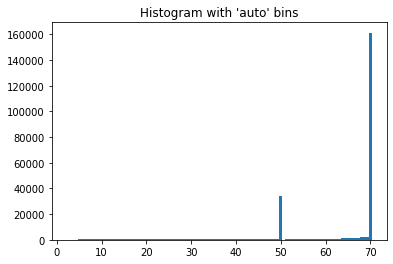

In [20]:
_ = plt.hist(df_conc['speed'], bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram with 'auto' bins")
plt.show()

In [21]:
df_conc[df_conc['speed'].apply(np.floor) < df_conc['speedLimitKph']]

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed
99,678443,36117,50,2021-03-05 08:25:00,2664,10,48.806757
100,678443,36117,50,2021-03-05 08:30:00,7501,9,17.333849
101,678443,36117,50,2021-03-05 08:35:00,7990,10,16.272991
102,678443,36117,50,2021-03-05 08:40:00,8199,10,15.858178
103,678443,36117,50,2021-03-05 08:45:00,8617,10,15.088917
...,...,...,...,...,...,...,...
263218,678982,24223,70,2021-03-04 09:05:00,3064,10,28.460444
263219,678982,24223,70,2021-03-04 09:10:00,2879,10,30.289267
263223,678982,24223,70,2021-03-04 09:30:00,1278,10,68.233803
263265,678982,24223,70,2021-03-04 13:00:00,1246,10,69.986196


In [22]:
df_conc[df_conc['speed'] > df_conc['speedLimitKph']]
# limitini aşan speed değerleri ondalikli kisimlarla aşmış

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154
1,678443,36117,50,2021-03-05 00:05:00,2600,10,50.008154
2,678443,36117,50,2021-03-05 00:10:00,2600,10,50.008154
3,678443,36117,50,2021-03-05 00:15:00,2600,10,50.008154
4,678443,36117,50,2021-03-05 00:20:00,2600,10,50.008154
...,...,...,...,...,...,...,...
263391,678982,24223,70,2021-03-04 23:35:00,1245,10,70.042410
263392,678982,24223,70,2021-03-04 23:40:00,1245,10,70.042410
263393,678982,24223,70,2021-03-04 23:45:00,1245,10,70.042410
263394,678982,24223,70,2021-03-04 23:50:00,1245,10,70.042410


In [23]:
df_conc.describe()

,segmentId,lengthmm,speedLimitKph,travelTime,coverage,speed
count,2.633960e+05,263396.000000,263396.000000,263396.000000,263396.000000,263396.000000
mean,2.341656e+06,39038.371706,65.961518,2952.567689,9.964931,60.112329
std,2.542222e+06,10822.673921,8.028733,3265.601977,0.308643,16.494523
min,1.310160e+05,4879.000000,50.000000,250.000000,1.000000,2.330237
25%,6.761070e+05,35376.000000,70.000000,2009.000000,10.000000,50.011503
50%,1.202901e+06,41194.000000,70.000000,2336.000000,10.000000,70.003260
75%,4.320016e+06,48241.000000,70.000000,2541.000000,10.000000,70.023392
max,7.452952e+06,49361.000000,70.000000,75943.000000,10.000000,70.257600


In [24]:
df_conc_ = df_conc.copy()

In [25]:
df_conc_['limitBreak'] = np.where(df_conc_['speed'] > df_conc_['speedLimitKph'], 1, 0)
df_conc['limitBreak'] = np.where(df_conc['speed'] > df_conc['speedLimitKph'], 1, 0)
#
df_test['limitBreak'] = np.where(df_test['speed'] > df_test['speedLimitKph'], 1, 0)
df_test['limitBreak'] = np.where(df_test['speed'] > df_test['speedLimitKph'], 1, 0)

In [26]:
df_conc_['limitBreak'].value_counts()

1    193947
0     69449
Name: limitBreak, dtype: int64

In [27]:
df_conc

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1
1,678443,36117,50,2021-03-05 00:05:00,2600,10,50.008154,1
2,678443,36117,50,2021-03-05 00:10:00,2600,10,50.008154,1
3,678443,36117,50,2021-03-05 00:15:00,2600,10,50.008154,1
4,678443,36117,50,2021-03-05 00:20:00,2600,10,50.008154,1
...,...,...,...,...,...,...,...,...
263391,678982,24223,70,2021-03-04 23:35:00,1245,10,70.042410,1
263392,678982,24223,70,2021-03-04 23:40:00,1245,10,70.042410,1
263393,678982,24223,70,2021-03-04 23:45:00,1245,10,70.042410,1
263394,678982,24223,70,2021-03-04 23:50:00,1245,10,70.042410,1


In [28]:
df_conc['limitBreak'] = df_conc['limitBreak'].astype('category')
df_conc['segmentId'] = df_conc['segmentId'].astype('category')
df_conc['speedLimitKph'] = df_conc['speedLimitKph'].astype('category')
#test
df_test['limitBreak'] = df_test['limitBreak'].astype('category')
df_test['segmentId'] = df_test['segmentId'].astype('category')
df_test['speedLimitKph'] = df_test['speedLimitKph'].astype('category')

In [29]:
df_conc['year'] = df_conc['discoveryTime'].dt.year
nmonth = df_conc['discoveryTime'].dt.month
df_conc['month'] = nmonth
df_conc['weekday']= df_conc['discoveryTime'].dt.weekday
days_each_month = np.cumsum(np.array([0,31,28,31,30,31,30,31,31,30,31,30,31]))
nday = [days_each_month[arg-1] for arg in nmonth.values]
nday = nday + df_conc["discoveryTime"].dt.day.values
df_conc['day'] = nday
df_conc['hour'] = df_conc['discoveryTime'].dt.hour
df_conc['minute']=df_conc['hour']*60.0+df_conc["discoveryTime"].dt.minute

df_conc.loc[:5,['discoveryTime', 'year', 'month', 'weekday', 'day', 'hour', 'minute']] # day yılda , minute günde bazlıdır

#test

df_test['year'] = df_test['discoveryTime'].dt.year
nmonth = df_test['discoveryTime'].dt.month
df_test['month'] = nmonth
df_test['weekday']= df_test['discoveryTime'].dt.weekday
days_each_month = np.cumsum(np.array([0,31,28,31,30,31,30,31,31,30,31,30,31]))
nday = [days_each_month[arg-1] for arg in nmonth.values]
nday = nday + df_test["discoveryTime"].dt.day.values
df_test['day'] = nday
df_test['hour'] = df_test['discoveryTime'].dt.hour
df_test['minute']=df_test['hour']*60.0+df_test["discoveryTime"].dt.minute

df_test.loc[:5,['discoveryTime', 'year', 'month', 'weekday', 'day', 'hour', 'minute']] # day yılda , minute günde bazlıdır

,discoveryTime,year,month,weekday,day,hour,minute
0,2021-03-15 00:00:00,2021,3,0,74,0,0.0
1,2021-03-15 00:05:00,2021,3,0,74,0,5.0
2,2021-03-15 00:10:00,2021,3,0,74,0,10.0
3,2021-03-15 00:15:00,2021,3,0,74,0,15.0
4,2021-03-15 00:20:00,2021,3,0,74,0,20.0
5,2021-03-15 00:25:00,2021,3,0,74,0,25.0


In [30]:
dataInfo=dataframeInformations(df_conc[['discoveryTime', 'year', 'month', 'weekday', 'day', 'hour', 'minute']])
variableList=[element for element in dataInfo['Variable'] ]
dataInfo=dataInfo.set_index('Variable')
dataInfo

,#_Total_Entry,#_Missing_Value,%_Missing_Value,Data_Type,Unique_Values,#_Uniques_Values
Variable,,,,,,
day,263396,0,0.0,int64,"[64, 62, 63]",3
discoveryTime,263396,0,0.0,datetime64[ns],"[2021-03-05T00:00:00.000000000, 2021-03-05T00:...",851
hour,263396,0,0.0,int64,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",24
minute,263396,0,0.0,float64,"[0.0, 5.0, 10.0, 15.0, 20.0, 26.0, 30.0, 35.0,...",308
month,263396,0,0.0,int64,[3],1
weekday,263396,0,0.0,int64,"[4, 2, 3]",3
year,263396,0,0.0,int64,[2021],1


In [31]:
df_conc.drop(['year', 'month', 'weekday', 'day'],axis=1,inplace=True)
df_conc
#test
df_test.drop(['year', 'month', 'weekday', 'day'],axis=1,inplace=True)
df_test

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-15 00:00:00,2600,10,50.008154,1,0,0.0
1,678443,36117,50,2021-03-15 00:05:00,2600,10,50.008154,1,0,5.0
2,678443,36117,50,2021-03-15 00:10:00,2600,10,50.008154,1,0,10.0
3,678443,36117,50,2021-03-15 00:15:00,2600,10,50.008154,1,0,15.0
4,678443,36117,50,2021-03-15 00:20:00,2600,10,50.008154,1,0,20.0
...,...,...,...,...,...,...,...,...,...,...
82578,678982,24223,70,2021-03-15 23:36:00,1245,10,70.042410,1,23,1416.0
82579,678982,24223,70,2021-03-15 23:41:00,1245,10,70.042410,1,23,1421.0
82580,678982,24223,70,2021-03-15 23:46:00,1245,10,70.042410,1,23,1426.0
82581,678982,24223,70,2021-03-15 23:51:00,1245,10,70.042410,1,23,1431.0


In [32]:
df_conc

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1,0,0.0
1,678443,36117,50,2021-03-05 00:05:00,2600,10,50.008154,1,0,5.0
2,678443,36117,50,2021-03-05 00:10:00,2600,10,50.008154,1,0,10.0
3,678443,36117,50,2021-03-05 00:15:00,2600,10,50.008154,1,0,15.0
4,678443,36117,50,2021-03-05 00:20:00,2600,10,50.008154,1,0,20.0
...,...,...,...,...,...,...,...,...,...,...
263391,678982,24223,70,2021-03-04 23:35:00,1245,10,70.042410,1,23,1415.0
263392,678982,24223,70,2021-03-04 23:40:00,1245,10,70.042410,1,23,1420.0
263393,678982,24223,70,2021-03-04 23:45:00,1245,10,70.042410,1,23,1425.0
263394,678982,24223,70,2021-03-04 23:50:00,1245,10,70.042410,1,23,1430.0


In [33]:
df_conc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 263396 entries, 0 to 263395
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   segmentId      263396 non-null  category      
 1   lengthmm       263396 non-null  int64         
 2   speedLimitKph  263396 non-null  category      
 3   discoveryTime  263396 non-null  datetime64[ns]
 4   travelTime     263396 non-null  int64         
 5   coverage       263396 non-null  int64         
 6   speed          263396 non-null  float64       
 7   limitBreak     263396 non-null  category      
 8   hour           263396 non-null  int64         
 9   minute         263396 non-null  float64       
dtypes: category(3), datetime64[ns](1), float64(2), int64(4)
memory usage: 25.2 MB


In [34]:
from sklearn.manifold import TSNE
import plotly.express as px

tsne_data = df_conc.drop(['discoveryTime','speedLimitKph','travelTime','coverage','limitBreak','minute'],axis=1).sample(1000)

tsne = TSNE(n_components=3, random_state=0)
projections = tsne.fit_transform(tsne_data)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2, color=tsne_data.speed, labels={'color': 'speed'}
)
fig.update_traces(marker_size=8)
fig.show()

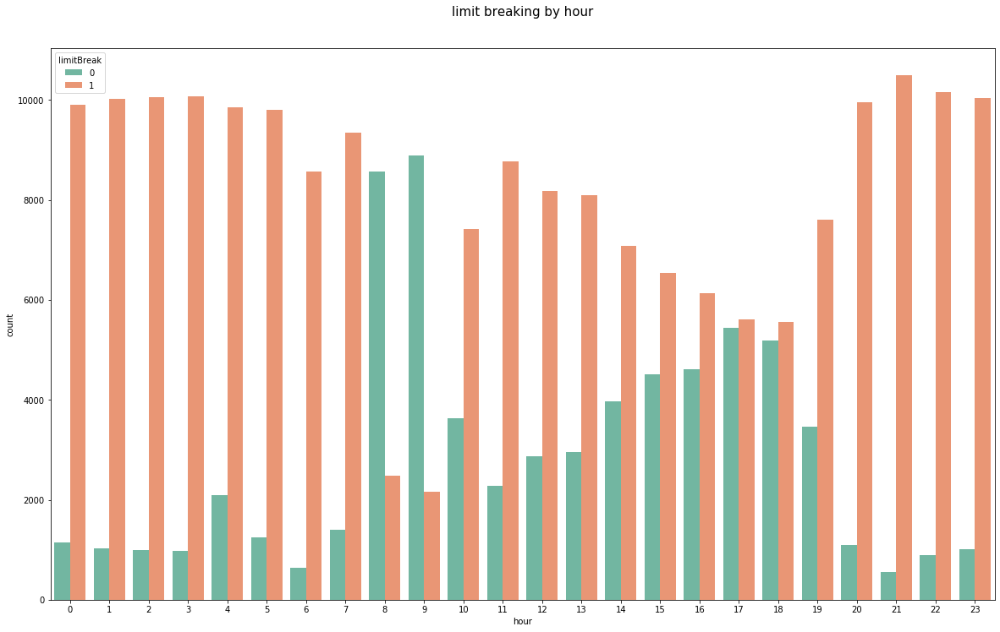

In [36]:
plt.figure(figsize=(20,12))
sns.countplot(x='hour', hue='limitBreak', data=df_conc ,palette="Set2")
plt.title('limit breaking by hour', size=15, y=1.05)
plt.show()

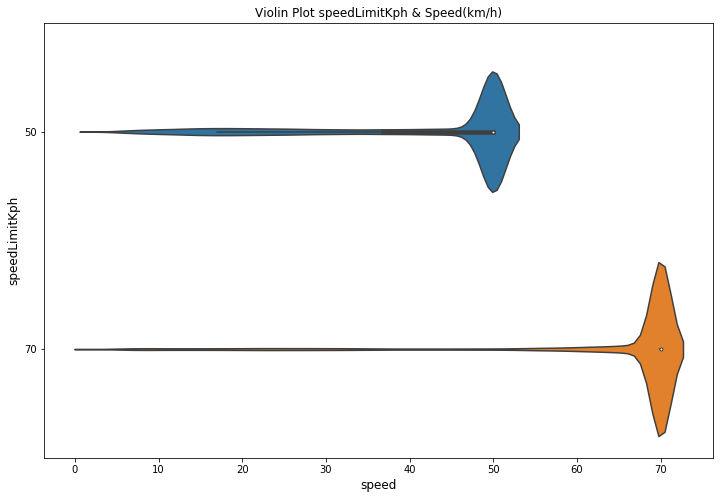

In [37]:
plt.figure(figsize=(12,8))
plt.title("Violin Plot speedLimitKph & Speed(km/h)")
sns.violinplot(x='speed', y='speedLimitKph', data=df_conc[['speed','speedLimitKph']])#.astype('int64'))
plt.xlabel('speed', fontsize=12)
plt.ylabel('speedLimitKph', fontsize=12)
plt.show()

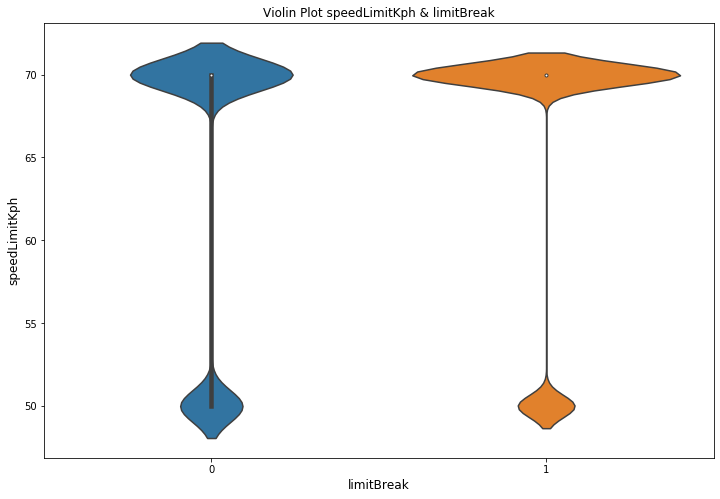

In [38]:
plt.figure(figsize=(12,8))
plt.title("Violin Plot speedLimitKph & limitBreak")
sns.violinplot(x='limitBreak', y='speedLimitKph', data=df_conc[['limitBreak','speedLimitKph']].astype('int64'))
plt.xlabel('limitBreak', fontsize=12)
plt.ylabel('speedLimitKph', fontsize=12)
plt.show()

In [39]:
df_conc['limitBreak'].value_counts()

1    193947
0     69449
Name: limitBreak, dtype: int64

In [40]:
ones = df_conc[df_conc['limitBreak']==1].sample(23572)
zeros = df_conc[df_conc['limitBreak']==0]
tempdf_plot = pd.concat([ones, zeros])

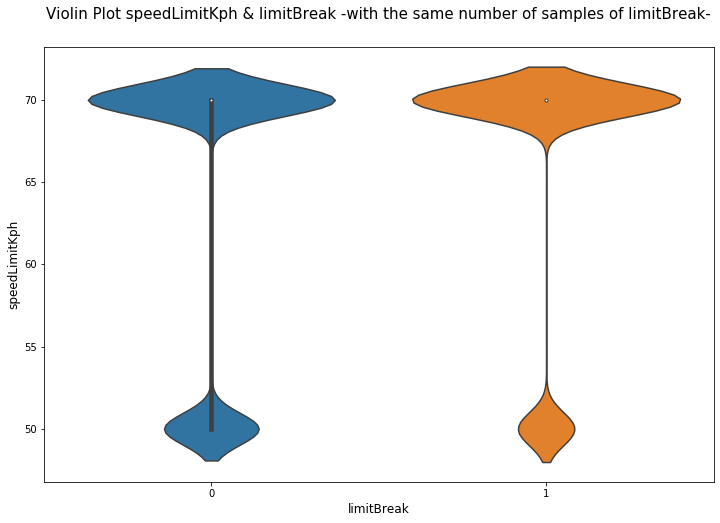

In [41]:
plt.figure(figsize=(12,8))
plt.title('Violin Plot speedLimitKph & limitBreak -with the same number of samples of limitBreak-', size=15, y=1.05)
sns.violinplot(x='limitBreak', y='speedLimitKph', data=tempdf_plot[['limitBreak','speedLimitKph']].astype('int64'))
plt.xlabel('limitBreak', fontsize=12)
plt.ylabel('speedLimitKph', fontsize=12)
plt.show()

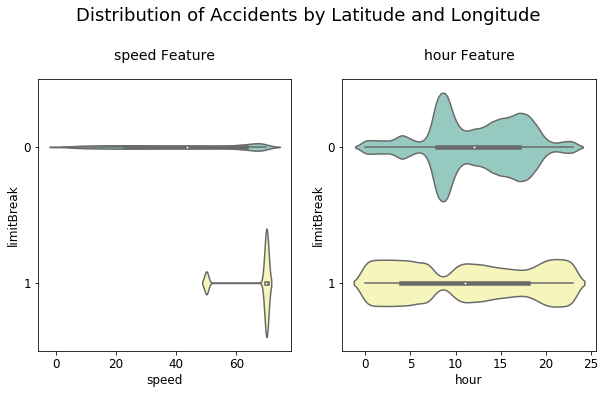

In [42]:
arr = ['speed', 'hour']
fig, axs = plt.subplots(ncols=1, nrows=2, figsize=(10, 5))
plt.subplots_adjust(hspace=0.4,wspace = 0.2)
for i, feature in enumerate(arr, 1):    
    plt.subplot(1, 2, i)
    sns.violinplot(x=feature, y="limitBreak", data=df_conc, palette="Set3")
    
    plt.xlabel('{}'.format(feature), size=12, labelpad=3)
    plt.ylabel('limitBreak', size=12, labelpad=3)    
    plt.tick_params(axis='x', labelsize=12)
    plt.tick_params(axis='y', labelsize=12)

    plt.title('{} Feature'.format(feature), size=14, y=1.05)
fig.suptitle('Distribution of Accidents by Latitude and Longitude', fontsize=18,y=1.08)
plt.show()

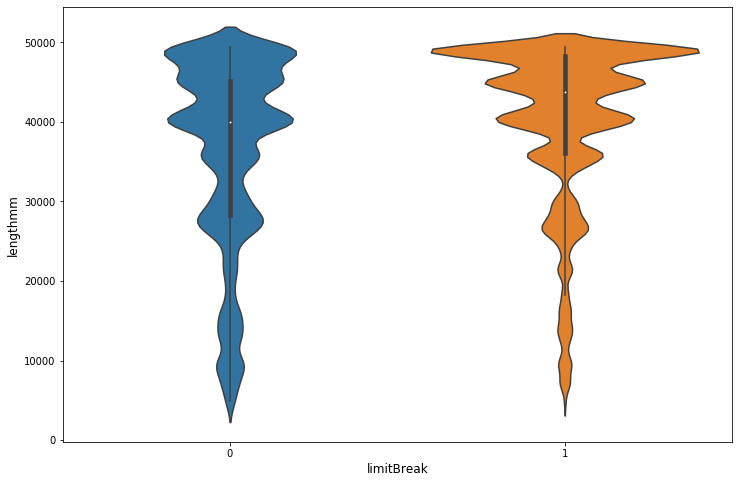

In [43]:
plt.figure(figsize=(12,8))
sns.violinplot(x='limitBreak', y='lengthmm', data=df_conc_[['limitBreak','lengthmm']].astype('int64'))
plt.xlabel('limitBreak', fontsize=12)
plt.ylabel('lengthmm', fontsize=12)
plt.show()

In [44]:
df_conc #coverage tut.

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1,0,0.0
1,678443,36117,50,2021-03-05 00:05:00,2600,10,50.008154,1,0,5.0
2,678443,36117,50,2021-03-05 00:10:00,2600,10,50.008154,1,0,10.0
3,678443,36117,50,2021-03-05 00:15:00,2600,10,50.008154,1,0,15.0
4,678443,36117,50,2021-03-05 00:20:00,2600,10,50.008154,1,0,20.0
...,...,...,...,...,...,...,...,...,...,...
263391,678982,24223,70,2021-03-04 23:35:00,1245,10,70.042410,1,23,1415.0
263392,678982,24223,70,2021-03-04 23:40:00,1245,10,70.042410,1,23,1420.0
263393,678982,24223,70,2021-03-04 23:45:00,1245,10,70.042410,1,23,1425.0
263394,678982,24223,70,2021-03-04 23:50:00,1245,10,70.042410,1,23,1430.0


In [45]:
sorter = list(df_static['segmentId'].values)

In [46]:
df_conc.segmentId.cat.set_categories(sorter, inplace=True)
#test
df_test.segmentId.cat.set_categories(sorter, inplace=True)

In [47]:
df_conc = df_conc.sort_values(["segmentId"])
#test
df_test = df_test.sort_values(["segmentId"])

In [48]:
df_conc

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1,0,0.0
564,678443,36117,50,2021-03-03 23:20:00,2600,10,50.008154,1,23,1400.0
565,678443,36117,50,2021-03-03 23:25:00,2600,10,50.008154,1,23,1405.0
566,678443,36117,50,2021-03-03 23:30:00,2600,10,50.008154,1,23,1410.0
567,678443,36117,50,2021-03-03 23:35:00,2600,10,50.008154,1,23,1415.0
...,...,...,...,...,...,...,...,...,...,...
262827,678982,24223,70,2021-03-03 00:05:00,1245,10,70.042410,1,0,5.0
262828,678982,24223,70,2021-03-03 00:10:00,1245,10,70.042410,1,0,10.0
262829,678982,24223,70,2021-03-03 00:15:00,1245,10,70.042410,1,0,15.0
262831,678982,24223,70,2021-03-03 00:25:00,1245,10,70.042410,1,0,25.0


In [49]:
df_conc.coverage.unique()

array([10,  9,  8,  6,  4,  3,  5,  1,  2,  7], dtype=int64)

In [50]:
df_static.segmentId.unique() # unique printi array dfdeki sirayla geliyor 

array([ 678443,  678442,  678441,  678400,  678399, 7452952, 7452951,
       7452950,  183156, 1211996, 1211995, 1260541, 1260540,  220354,
        220353,  220352,  220351,  198812, 2065593, 4320016, 4320015,
       4320014, 6307512, 6307511,  678398,  198807,  198806,  198790,
        198789,  198788,  198787,  206050,  206049,  206048,  206047,
        206046,  206045,  206037, 1204298, 1204297, 1204296,  198786,
       7425669, 7425668, 7425667,  216446,  216445,  216444, 1232809,
       1232808, 1232807, 1232806, 1232805, 1232804, 1232803, 1232802,
        198785,  225698,  225697,  678981,  678980,  865223, 1037406,
       1037405, 1037404, 1040008, 1037403, 1037409, 5915037, 5915038,
       1037399, 6134396, 6134398, 6134397, 1037410, 1038973, 1038972,
       1037414, 1037355,  198784,  198783, 1215936, 1215935, 1215934,
       1215933, 1215928, 1215927, 1215926, 1215925, 1215924, 1215923,
       1215922, 1215921, 1215920,  184686, 1202902, 1202901, 2199192,
       2199191, 2199

In [51]:
df_static.segmentId.unique() == df_conc.segmentId.unique() 

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

In [52]:
df_repl = df_conc.loc[df_conc.index.repeat(df_conc['coverage'])].drop('coverage',axis=1)

In [53]:
df_repl

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0
...,...,...,...,...,...,...,...,...,...
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0


In [60]:
df_corridor['segmentIdNew'] = df_corridor.index.values

counter=-1
for i in df_corridor.segmentId:
    counter = counter +1
    df_repl.loc[df_repl['segmentId']==i,'segmentIdNew'] = df_corridor['segmentIdNew'][counter]

df_repl['segmentIdNew'] = df_repl['segmentIdNew'].astype('int64')
df_repl['segmentIdNew'] = df_repl['segmentIdNew'].astype('category')
df_repl

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,speed,limitBreak,hour,minute,segmentIdNew
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306


In [61]:
df_repl.groupby(['segmentId', 'hour'])['speed'].size()

segmentId  hour
678443     0       359
           1       359
           2       356
           3       321
           4       172
                  ... 
678982     19      359
           20      358
           21      359
           22      359
           23      359
Name: speed, Length: 7368, dtype: int64

In [62]:
df_repl.groupby(['segmentId', 'hour'])['speed'].sum()

segmentId  hour
678443     0       17952.927231
           1       17952.927231
           2       17802.902769
           3       16052.617385
           4        8601.402462
                       ...     
678982     19      25145.225060
           20      25075.182651
           21      25145.225060
           22      25141.865712
           23      25104.355745
Name: speed, Length: 7368, dtype: float64

In [63]:
df_repl['flow'] = df_repl.groupby(['segmentId', 'hour'])['speed'].transform('size')
df_repl['meanspeed'] = df_repl.groupby(['segmentId', 'hour'])['speed'].transform('sum') / df_repl.groupby(['segmentId', 'hour'])['speed'].transform('size')
df_repl['density'] = df_repl['flow'] / df_repl['meanspeed']
df_repl.drop('meanspeed',axis=1,inplace=True)
df_repl

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,speed,limitBreak,hour,minute,segmentIdNew,flow,density
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7.178829
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7.178829
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7.178829
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7.178829
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7.178829
...,...,...,...,...,...,...,...,...,...,...,...,...
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5.133810
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5.133810
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5.133810
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5.133810


In [64]:
df_repl.density.describe()

count    2.624723e+06
mean     6.607298e+00
std      3.259797e+00
min      3.198320e+00
25%      5.141139e+00
50%      5.195814e+00
75%      7.158679e+00
max      3.945371e+01
Name: density, dtype: float64

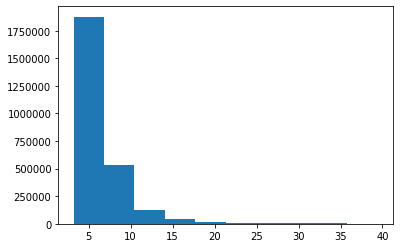

In [65]:
plt.hist(df_repl.density)
plt.show()

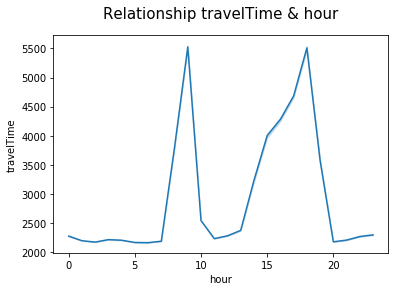

In [66]:
plt.title('Relationship travelTime & hour', size=15, y=1.05)
sns.lineplot(x="hour", y="travelTime", data=df_repl)

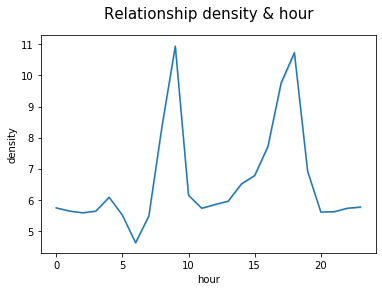

In [67]:
plt.title('Relationship density & hour', size=15, y=1.05)
sns.lineplot(x="hour", y="density", data=df_repl)

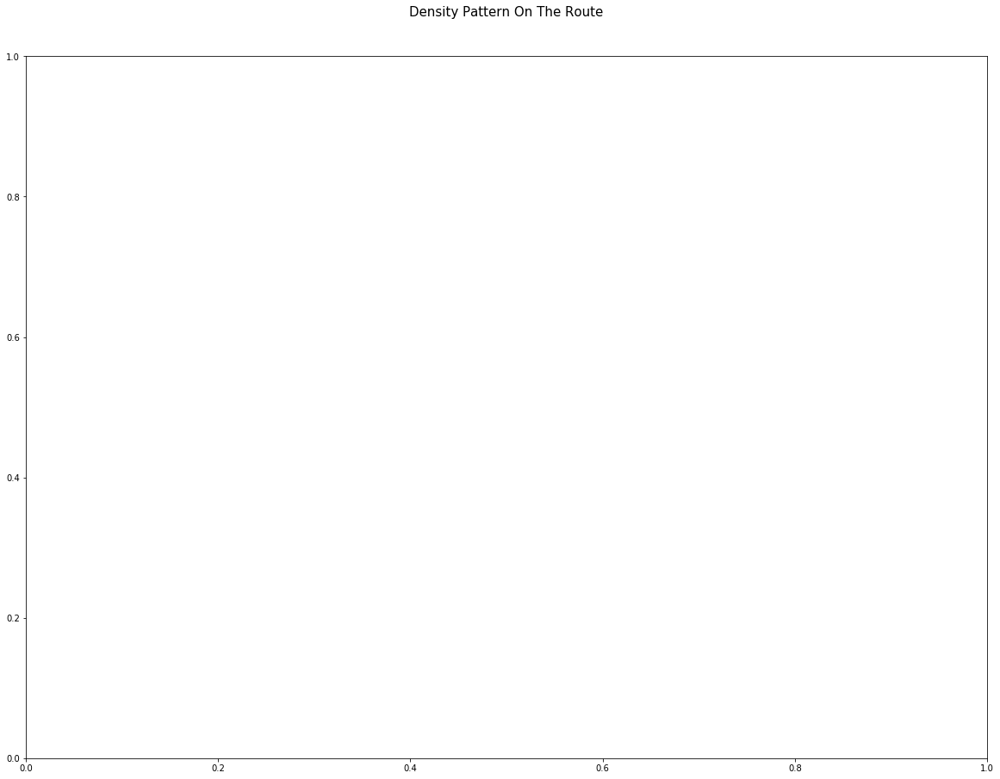

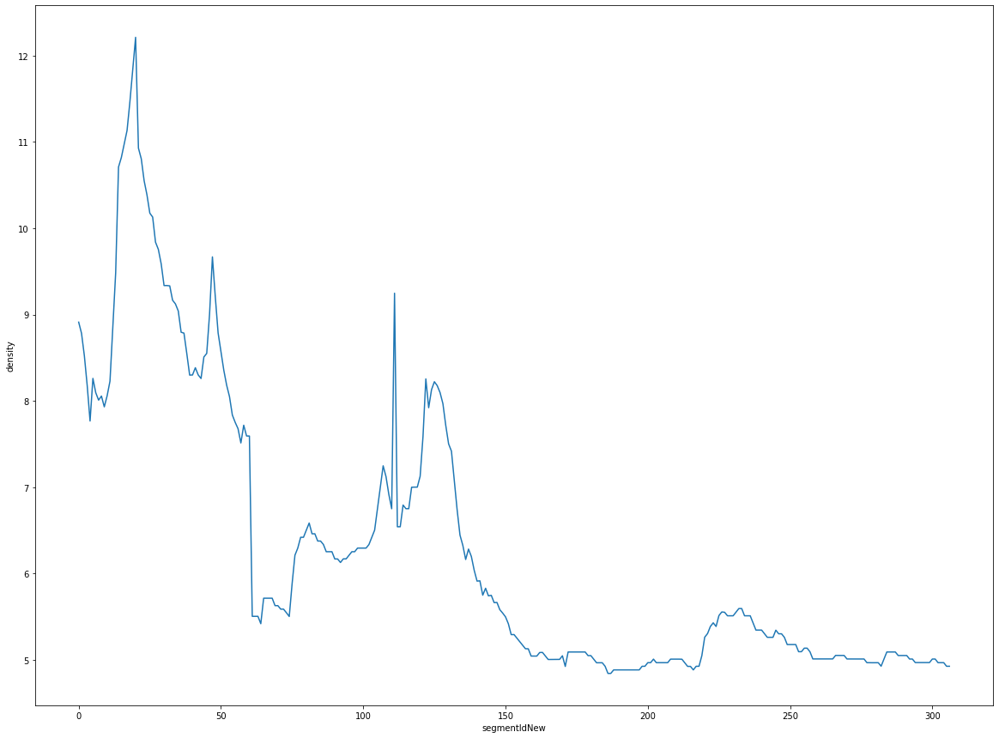

In [68]:
#pattern of density on the route
temp = ['segmentIdNew','density']
df_repl[temp] = df_repl[temp].apply(lambda x: x.astype('int64'))

plt.figure(figsize=(20,15))
plt.title('Density Pattern On The Route', size=15, y=1.05)
fig, ax = plt.subplots(figsize=(20,15))

df_repl.groupby('segmentIdNew')['density'].mean().plot(kind='line',ax=ax)
x_axes = df_repl.segmentIdNew.unique()
#plt.xticks(x_axes,rotation='vertical',fontweight='light')
#plt.locator_params(axis='x_axes', nbins=len(x_axes)/10)
plt.ylabel('density')

df_repl[temp] = df_repl[temp].apply(lambda x: x.astype('category'))
plt.show()

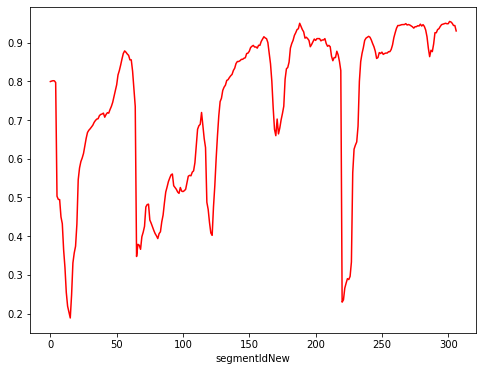

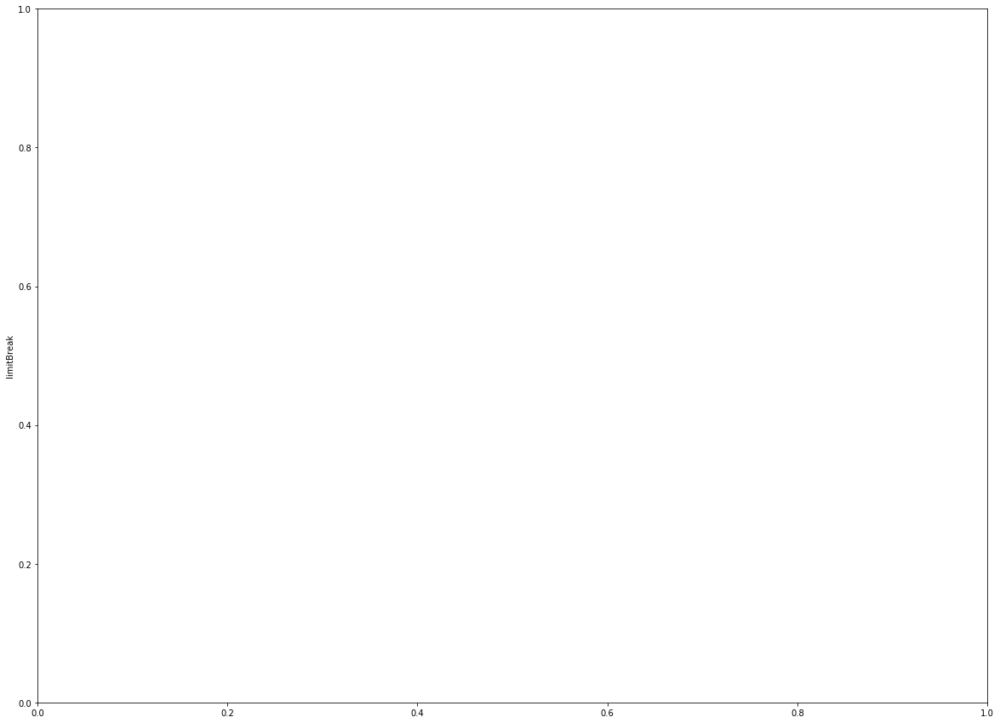

In [69]:
temp = ['segmentIdNew','limitBreak']
df_repl[temp] = df_repl[temp].apply(lambda x: x.astype('int64'))

fig, ax = plt.subplots(figsize=(8,6))

plt.figure(figsize=(20,15))
df_repl.groupby('segmentIdNew')['limitBreak'].mean().plot(kind='line',color='red',ax=ax)
#x_axes = df_conc.segmentIdNew.unique()
#plt.xticks(x_axes,rotation='vertical',fontweight='light')
#plt.locator_params(axis='x_axes', nbins=len(x_axes)/10)
plt.ylabel('limitBreak')

df_repl[temp] = df_repl[temp].apply(lambda x: x.astype('category'))

plt.show()

In [70]:
df_conc[df_conc['speed'] > 50 ]['speed'].unique()[0:90]

array([50.00815385, 50.02627119, 50.0021611 , 50.01310345, 50.00070985,
       50.01349239, 50.00125245, 50.00172573, 50.00162437, 50.07615063,
       50.01419536, 50.00573183, 50.01021332, 50.01986409, 50.00152672,
       50.00419948, 50.00226933, 50.00922659, 50.02354086, 50.01361257,
       50.00115274, 50.00061209, 50.0041301 , 50.00143697, 50.01133603,
       50.01150342, 50.03260437, 50.00260542, 50.07223065, 50.02582311,
       70.00375587, 67.3005015 , 67.33426994, 68.43304437, 65.3345667 ,
       68.46795918, 67.84489383, 57.34923077, 69.894375  , 56.07906394,
       53.42245223, 68.71336406, 69.96725756, 62.09958353, 64.82956522,
       61.36131687, 63.00338028, 62.12833333, 67.1993991 , 67.53759436,
       68.32851324, 69.82164412, 57.20255754, 61.19343365, 66.335739  ,
       63.54034091, 60.34046763, 66.96467066, 66.46716196, 61.81354215,
       54.79673336, 70.01135371, 66.62898701, 66.66361746, 69.44277206,
       69.48039003, 69.10603448, 67.82696986, 63.2137999 , 69.66

In [71]:
tempdf = df_conc[df_conc['speedLimitKph'] == 50]
tempdf[tempdf['speed'] > 50 ]['speed'].unique()[0:90]

array([50.00815385, 50.02627119, 50.0021611 , 50.01310345, 50.00070985,
       50.01349239, 50.00125245, 50.00172573, 50.00162437, 50.07615063,
       50.01419536, 50.00573183, 50.01021332, 50.01986409, 50.00152672,
       50.00419948, 50.00226933, 50.00922659, 50.02354086, 50.01361257,
       50.00115274, 50.00061209, 50.0041301 , 50.00143697, 50.01133603,
       50.01150342, 50.03260437, 50.00260542, 50.07223065, 50.02582311,
       50.04146341])

In [72]:
tempdf50 = df_conc[df_conc['speedLimitKph'] == 50]['speed']
tempdf70 = df_conc[df_conc['speedLimitKph'] == 70]['speed']

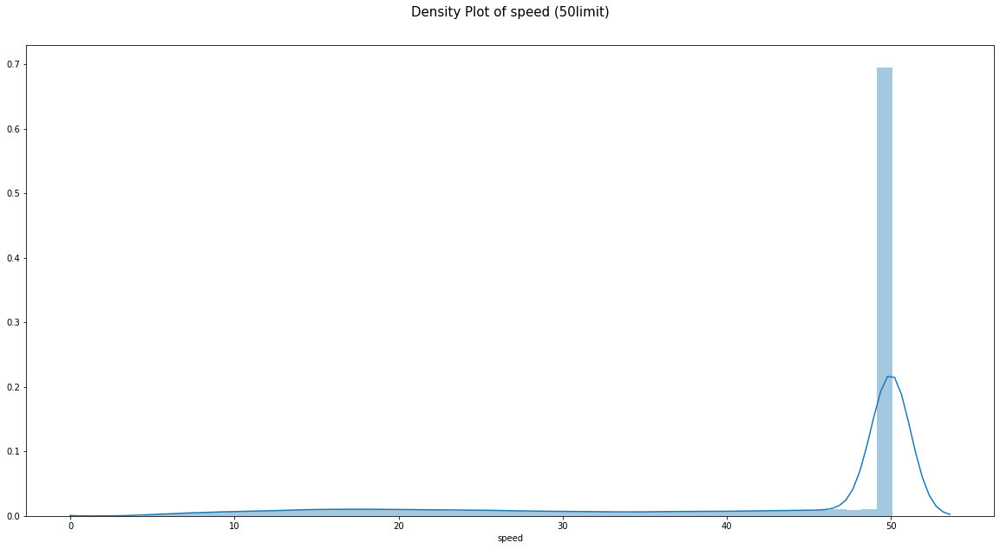

In [73]:
plt.figure(figsize=(20,10))
plt.title('Density Plot of speed (50limit)', size=15, y=1.05)
ax = sns.distplot(tempdf50) 

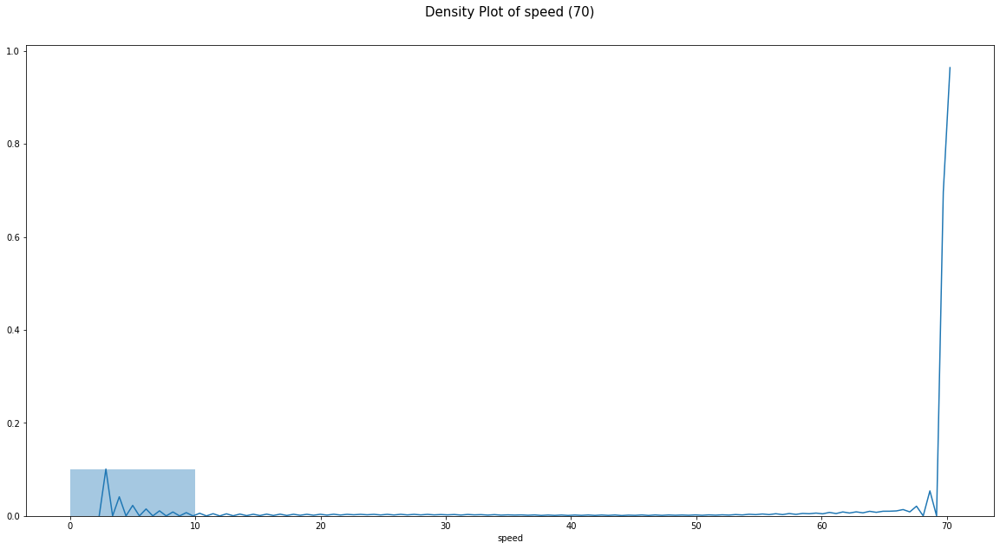

In [74]:
plt.figure(figsize=(20,10))
plt.title('Density Plot of speed (70)', size=15, y=1.05)
ax = sns.distplot(tempdf70,bins=[0,10]) 

In [75]:
df_seg = df_repl[df_repl['segmentId']==1202901]

In [76]:
x_ ,y_ = zip(*sorted(zip(df_seg.density,df_seg.flow),key=lambda x: x[0]))

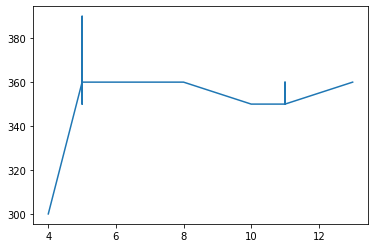

In [77]:
plt.plot(x_,y_)

In [78]:
'''dfobj = df_repl.groupby('segmentId')
   df_repl['congestion'] = np.where(dfobj['density'] > (dfobj[dfobj['flow'] == dfobj['flow'].max()]['density']), 1, 0)
'''

"dfobj = df_repl.groupby('segmentId')\n   df_repl['congestion'] = np.where(dfobj['density'] > (dfobj[dfobj['flow'] == dfobj['flow'].max()]['density']), 1, 0)\n"

In [79]:
df_repl['hour'].value_counts(normalize=True)

4     0.045099
22    0.042076
21    0.042067
1     0.042067
13    0.042065
20    0.042064
0     0.042063
12    0.042059
23    0.042057
11    0.042049
14    0.042031
10    0.042024
19    0.042012
2     0.041999
3     0.041983
8     0.041898
9     0.041884
17    0.041865
15    0.041806
5     0.041438
7     0.040889
16    0.040820
18    0.040776
6     0.034910
Name: hour, dtype: float64

In [80]:
df50 = df_repl[df_repl['speedLimitKph']==50]
df70 = df_repl[df_repl['speedLimitKph']==70]
temp = ['segmentId','limitBreak']
df50[temp] = df50[temp].apply(lambda x: x.astype('int64'))
df70[temp] = df70[temp].apply(lambda x: x.astype('int64'))

C:\Users\kerem\Anaconda3\lib\site-packages\pandas\core\frame.py:3191: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
pd.DataFrame(df50.groupby('segmentId')['limitBreak'].mean().nlargest(3).transform(np.abs).reset_index())

,segmentId,limitBreak
0,198785,0.878473
1,225698,0.875131
2,1232802,0.871852


In [82]:
pd.DataFrame(df70.groupby('segmentId')['limitBreak'].mean().nlargest(3).transform(np.abs).reset_index())

,segmentId,limitBreak
0,5855956,0.954530
1,5855955,0.953364
2,676119,0.949883


In [83]:
df50[temp] = df50[temp].apply(lambda x: x.astype('category'))
df70[temp] = df70[temp].apply(lambda x: x.astype('category'))

C:\Users\kerem\Anaconda3\lib\site-packages\pandas\core\frame.py:3191: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



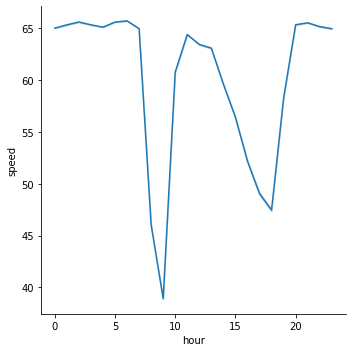

In [84]:
sns.relplot(x="hour", y="speed", kind="line", data=df_repl);

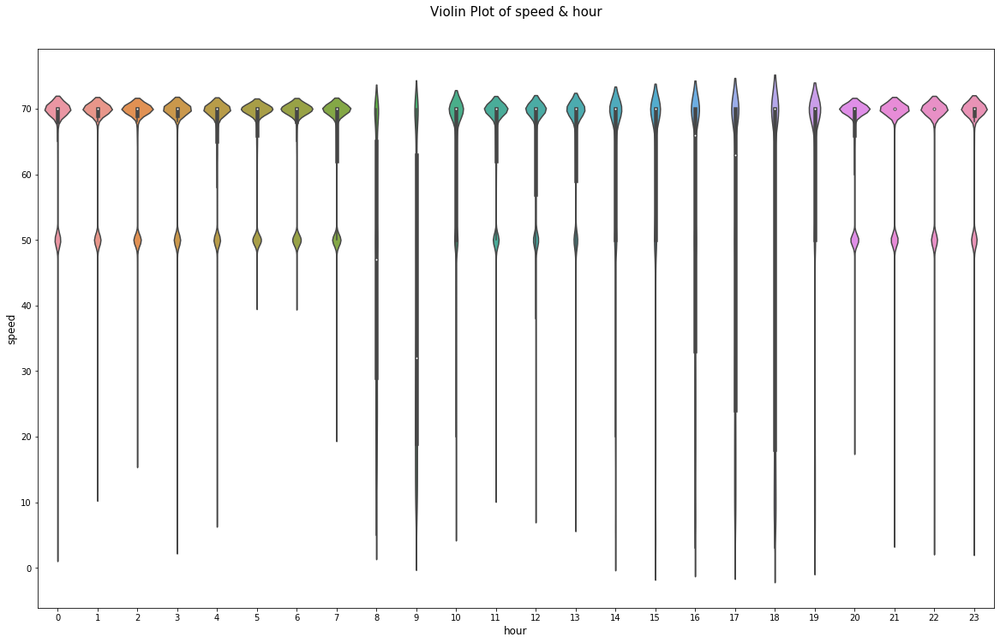

In [85]:
plt.figure(figsize=(20,12))
plt.title('Violin Plot of speed & hour', size=15, y=1.05)
sns.violinplot(x='hour', y='speed', data=df_repl[['hour','speed']].astype('int64'))
plt.xlabel('hour', fontsize=12)
plt.ylabel('speed', fontsize=12)
plt.show()

In [86]:
df_corridor = df_static[['segmentId','lengthmm']]

In [87]:
df_corridor['cumLengthmm']= df_corridor['lengthmm'].cumsum()

In [88]:
df_corridor

,segmentId,lengthmm,cumLengthmm
0,678443,36117,36117
1,678442,36117,72234
2,678441,36117,108351
3,678400,26236,134587
4,678399,26236,160823
...,...,...,...
302,5855955,45003,11831605
303,5855954,45003,11876608
304,5855953,45003,11921611
305,5855963,38866,11960477


In [89]:
df_repl

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,speed,limitBreak,hour,minute,segmentIdNew,flow,density
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7
0,678443,36117,50,2021-03-05 00:00:00,2600,50.008154,1,0,0.0,0,359,7
...,...,...,...,...,...,...,...,...,...,...,...,...
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,23,1435.0,306,359,5


In [90]:
df_repl[df_repl['segmentId']==678443]['density'].unique()

[7, 6, 3, 32, 13, 12, 5, 10, 18, 8]
Categories (10, int64): [7, 6, 3, 32, ..., 5, 10, 18, 8]

In [91]:
temp = ['density']
df_repl[temp] = df_repl[temp].apply(lambda x: x.astype('int64'))

df_0_6 = df_repl.copy()
df_6_11 = df_repl.copy()
df_11_14 = df_repl.copy()
df_14_19 = df_repl.copy()
df_19_23 = df_repl.copy()

df_0_6.loc[df_0_6['hour'].between(0,6),'hour'] = '0-6 hours'
df_0_6 = df_0_6[df_0_6['hour']=='0-6 hours']
df_6_11.loc[df_6_11['hour'].between(6,11),'hour'] = '6-11 hours'
df_6_11 = df_6_11[df_6_11['hour']=='6-11 hours']
df_11_14.loc[df_11_14['hour'].between(11,14),'hour'] = '11-14 hours'
df_11_14 = df_11_14[df_11_14['hour']=='11-14 hours']
df_14_19.loc[df_14_19['hour'].between(14,19),'hour'] = '14-19 hours'
df_14_19 = df_14_19[df_14_19['hour']=='14-19 hours']
df_19_23.loc[df_19_23['hour'].between(19,23),'hour'] = '19-23 hours'
df_19_23 = df_19_23[df_19_23['hour']=='19-23 hours']

In [92]:
df_0_6['meanDensity'] = df_0_6.groupby(['segmentId'])['density'].transform('mean')
df_0_6.drop('density',axis=1,inplace=True)
df_6_11['meanDensity'] = df_6_11.groupby(['segmentId'])['density'].transform('mean')
df_6_11.drop('density',axis=1,inplace=True)
df_11_14['meanDensity'] = df_11_14.groupby(['segmentId'])['density'].transform('mean')
df_11_14.drop('density',axis=1,inplace=True)
df_14_19['meanDensity'] = df_14_19.groupby(['segmentId'])['density'].transform('mean')
df_14_19.drop('density',axis=1,inplace=True)
df_19_23['meanDensity'] = df_19_23.groupby(['segmentId'])['density'].transform('mean')
df_19_23.drop('density',axis=1,inplace=True)

In [93]:
df_19_23

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,speed,limitBreak,hour,minute,segmentIdNew,flow,meanDensity
564,678443,36117,50,2021-03-03 23:20:00,2600,50.008154,1,19-23 hours,1400.0,0,360,8.19598
564,678443,36117,50,2021-03-03 23:20:00,2600,50.008154,1,19-23 hours,1400.0,0,360,8.19598
564,678443,36117,50,2021-03-03 23:20:00,2600,50.008154,1,19-23 hours,1400.0,0,360,8.19598
564,678443,36117,50,2021-03-03 23:20:00,2600,50.008154,1,19-23 hours,1400.0,0,360,8.19598
564,678443,36117,50,2021-03-03 23:20:00,2600,50.008154,1,19-23 hours,1400.0,0,360,8.19598
...,...,...,...,...,...,...,...,...,...,...,...,...
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,19-23 hours,1435.0,306,359,5.00000
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,19-23 hours,1435.0,306,359,5.00000
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,19-23 hours,1435.0,306,359,5.00000
263395,678982,24223,70,2021-03-04 23:55:00,1245,70.042410,1,19-23 hours,1435.0,306,359,5.00000


In [94]:
df_19_23.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs)

segmentId
678443     8.195980
678442     7.997758
678441     8.003373
678400     7.604389
678399     7.401476
             ...   
5855955    5.000000
5855954    5.000000
5855953    5.000000
5855963    5.000000
678982     5.000000
Name: meanDensity, Length: 307, dtype: float64

In [95]:
df_14_19.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs)

segmentId
678443     35.744864
678442     36.396068
678441     37.279896
678400     37.688393
678399     38.324923
             ...    
5855955    70.013310
5855954    70.013310
5855953    70.013310
5855963    70.028829
678982     70.015785
Name: speed, Length: 307, dtype: float64

In [96]:
df_corridor['meanSpeed_0_6'] = np.array(df_0_6.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs))
df_corridor['meanSpeed_6_11'] = np.array(df_6_11.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs))
df_corridor['meanSpeed_11_14'] = np.array(df_11_14.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs))
df_corridor['meanSpeed_14_19'] = np.array(df_14_19.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs))
df_corridor['meanSpeed_19_23'] = np.array(df_19_23.groupby(['segmentId'],observed=True)['speed'].mean().transform(np.abs))

In [97]:
df_corridor['meanDensity_0_6'] = np.array(df_0_6.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs))
df_corridor['meanDensity_6_11'] = np.array(df_6_11.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs))
df_corridor['meanDensityd_11_14'] = np.array(df_11_14.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs))
df_corridor['meanDensity_14_19'] = np.array(df_14_19.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs))
df_corridor['meanDensity_19_23'] = np.array(df_19_23.groupby(['segmentId'],observed=True)['meanDensity'].mean().transform(np.abs))

In [98]:
df_corridor

,segmentId,lengthmm,cumLengthmm,meanSpeed_0_6,meanSpeed_6_11,meanSpeed_11_14,meanSpeed_14_19,meanSpeed_19_23,meanDensity_0_6,meanDensity_6_11,meanDensityd_11_14,meanDensity_14_19,meanDensity_19_23
0,678443,36117,36117,50.008154,40.146629,49.239685,35.744864,45.157143,5.904213,9.185910,7.0,12.914514,8.195980
1,678442,36117,72234,49.970485,40.487815,49.147990,36.396068,45.548968,5.904116,9.004423,7.0,12.593133,7.997758
2,678441,36117,108351,49.937678,41.033953,49.178181,37.279896,45.828778,5.900555,8.656665,7.0,11.925212,8.003373
3,678400,26236,134587,49.955116,41.515265,49.122087,37.688393,46.152167,5.720081,8.309817,7.0,11.277516,7.604389
4,678399,26236,160823,49.960841,41.947122,49.069357,38.324923,46.460368,5.351938,7.959123,7.0,10.404478,7.401476
...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,5855955,45003,11831605,69.939104,64.695197,70.013310,70.013310,70.011297,4.879421,5.200957,5.0,4.672897,5.000000
303,5855954,45003,11876608,69.932671,65.145717,70.013310,70.013310,70.005849,4.879421,5.200957,5.0,4.672897,5.000000
304,5855953,45003,11921611,69.738526,65.395946,70.013310,70.013310,69.995545,4.879421,5.200957,5.0,4.672897,5.000000
305,5855963,38866,11960477,69.764277,65.685801,70.028829,70.028829,70.004879,4.879775,5.029201,5.0,4.672897,5.000000


In [99]:
df_corridor['lengthKm'] = df_corridor['lengthmm'] / 1000000

In [100]:
df_corridor['lengthKm'].max() , df_corridor['lengthKm'].min()

(0.049361, 0.004879)

In [101]:
df_corridor['cumLengthKm'] = df_corridor['lengthKm'].cumsum()

In [102]:
df_corridor

,segmentId,lengthmm,cumLengthmm,meanSpeed_0_6,meanSpeed_6_11,meanSpeed_11_14,meanSpeed_14_19,meanSpeed_19_23,meanDensity_0_6,meanDensity_6_11,meanDensityd_11_14,meanDensity_14_19,meanDensity_19_23,lengthKm,cumLengthKm
0,678443,36117,36117,50.008154,40.146629,49.239685,35.744864,45.157143,5.904213,9.185910,7.0,12.914514,8.195980,0.036117,0.036117
1,678442,36117,72234,49.970485,40.487815,49.147990,36.396068,45.548968,5.904116,9.004423,7.0,12.593133,7.997758,0.036117,0.072234
2,678441,36117,108351,49.937678,41.033953,49.178181,37.279896,45.828778,5.900555,8.656665,7.0,11.925212,8.003373,0.036117,0.108351
3,678400,26236,134587,49.955116,41.515265,49.122087,37.688393,46.152167,5.720081,8.309817,7.0,11.277516,7.604389,0.026236,0.134587
4,678399,26236,160823,49.960841,41.947122,49.069357,38.324923,46.460368,5.351938,7.959123,7.0,10.404478,7.401476,0.026236,0.160823
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,5855955,45003,11831605,69.939104,64.695197,70.013310,70.013310,70.011297,4.879421,5.200957,5.0,4.672897,5.000000,0.045003,11.831605
303,5855954,45003,11876608,69.932671,65.145717,70.013310,70.013310,70.005849,4.879421,5.200957,5.0,4.672897,5.000000,0.045003,11.876608
304,5855953,45003,11921611,69.738526,65.395946,70.013310,70.013310,69.995545,4.879421,5.200957,5.0,4.672897,5.000000,0.045003,11.921611
305,5855963,38866,11960477,69.764277,65.685801,70.028829,70.028829,70.004879,4.879775,5.029201,5.0,4.672897,5.000000,0.038866,11.960477


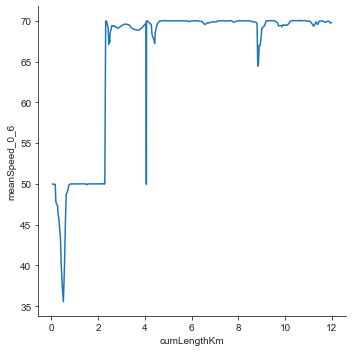

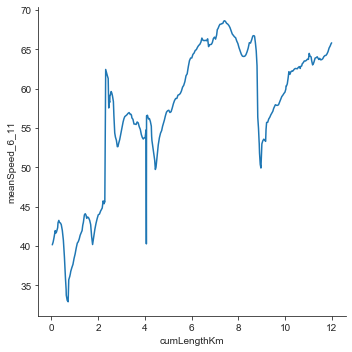

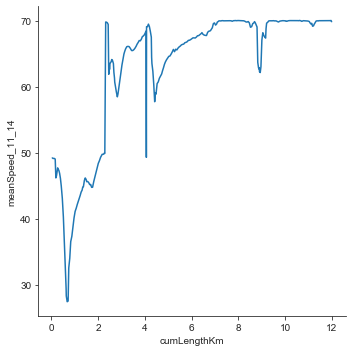

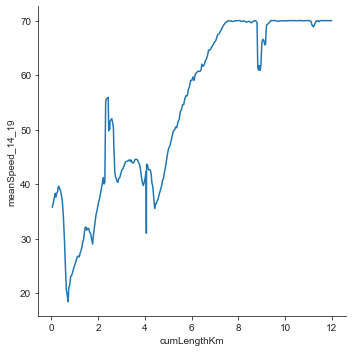

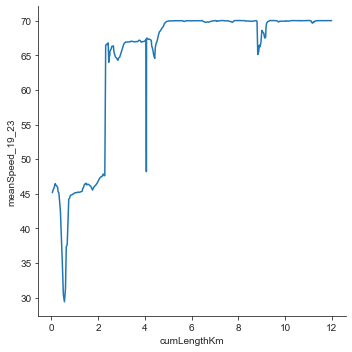

In [363]:
sns.relplot(x="cumLengthKm", y="meanSpeed_0_6", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanSpeed_6_11", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanSpeed_11_14", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanSpeed_14_19", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanSpeed_19_23", kind="line", data=df_corridor);

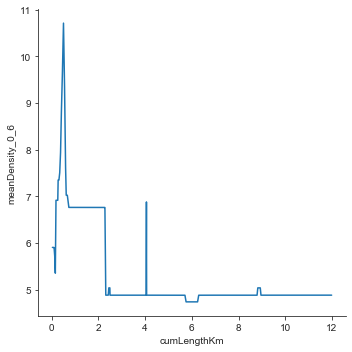

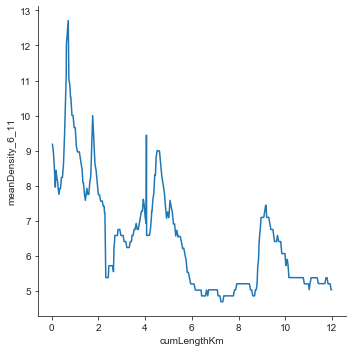

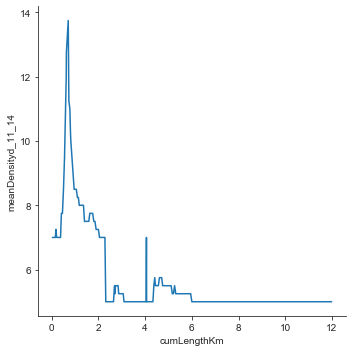

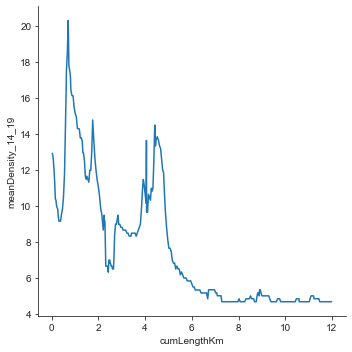

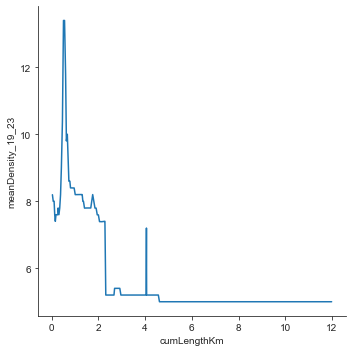

In [366]:
sns.relplot(x="cumLengthKm", y="meanDensity_0_6", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanDensity_6_11", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanDensityd_11_14", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanDensity_14_19", kind="line", data=df_corridor);
sns.relplot(x="cumLengthKm", y="meanDensity_19_23", kind="line", data=df_corridor);

In [105]:
# gelen veri hangi saatte hangi segmentte hiz verisi ise o kısıtlamanın güven aralığının dışında olup olmadığıyla anormal bir hız olup olmadığına karar verilebilir.

In [106]:
df_conc

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1,0,0.0
564,678443,36117,50,2021-03-03 23:20:00,2600,10,50.008154,1,23,1400.0
565,678443,36117,50,2021-03-03 23:25:00,2600,10,50.008154,1,23,1405.0
566,678443,36117,50,2021-03-03 23:30:00,2600,10,50.008154,1,23,1410.0
567,678443,36117,50,2021-03-03 23:35:00,2600,10,50.008154,1,23,1415.0
...,...,...,...,...,...,...,...,...,...,...
262827,678982,24223,70,2021-03-03 00:05:00,1245,10,70.042410,1,0,5.0
262828,678982,24223,70,2021-03-03 00:10:00,1245,10,70.042410,1,0,10.0
262829,678982,24223,70,2021-03-03 00:15:00,1245,10,70.042410,1,0,15.0
262831,678982,24223,70,2021-03-03 00:25:00,1245,10,70.042410,1,0,25.0


In [107]:
df_test

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute
0,678443,36117,50,2021-03-15 00:00:00,2600,10,50.008154,1,0,0.0
171,678443,36117,50,2021-03-15 14:15:00,2600,10,50.008154,1,14,855.0
172,678443,36117,50,2021-03-15 14:20:00,2600,10,50.008154,1,14,860.0
173,678443,36117,50,2021-03-15 14:25:00,2600,10,50.008154,1,14,865.0
174,678443,36117,50,2021-03-15 14:30:00,2600,10,50.008154,1,14,870.0
...,...,...,...,...,...,...,...,...,...,...
82409,678982,24223,70,2021-03-15 07:55:00,1245,10,70.042410,1,7,475.0
82410,678982,24223,70,2021-03-15 08:00:00,1245,10,70.042410,1,8,480.0
82411,678982,24223,70,2021-03-15 08:05:00,1245,10,70.042410,1,8,485.0
82397,678982,24223,70,2021-03-15 06:55:00,1245,10,70.042410,1,6,415.0


In [108]:
temp = df_conc[['discoveryTime','speed','coverage']]
temp.index = temp.discoveryTime
temp

,discoveryTime,speed,coverage
discoveryTime,,,
2021-03-05 00:00:00,2021-03-05 00:00:00,50.008154,10
2021-03-03 23:20:00,2021-03-03 23:20:00,50.008154,10
2021-03-03 23:25:00,2021-03-03 23:25:00,50.008154,10
2021-03-03 23:30:00,2021-03-03 23:30:00,50.008154,10
2021-03-03 23:35:00,2021-03-03 23:35:00,50.008154,10
...,...,...,...
2021-03-03 00:05:00,2021-03-03 00:05:00,70.042410,10
2021-03-03 00:10:00,2021-03-03 00:10:00,70.042410,10
2021-03-03 00:15:00,2021-03-03 00:15:00,70.042410,10


In [109]:
df_segment = df_conc[['discoveryTime','speed','coverage','segmentId']]

In [110]:
df_segment.groupby('segmentId')['coverage'].sum()

segmentId
678443     8054
678442     8030
678441     8010
678400     7993
678399     7896
           ... 
5855955    8577
5855954    8577
5855953    8577
5855963    8575
678982     8564
Name: coverage, Length: 307, dtype: int64

In [111]:
df_segment = df_segment[df_segment['segmentId']==134879 ]
df_segment = df_segment.drop('segmentId',axis=1)
df_segment.index = df_segment.discoveryTime
df_segment

,discoveryTime,speed,coverage
discoveryTime,,,
2021-03-03 23:55:00,2021-03-03 23:55:00,70.044851,10
2021-03-03 23:50:00,2021-03-03 23:50:00,70.044851,10
2021-03-03 23:45:00,2021-03-03 23:45:00,70.044851,10
2021-03-03 23:40:00,2021-03-03 23:40:00,70.044851,10
2021-03-03 23:15:00,2021-03-03 23:15:00,70.044851,10
...,...,...,...
2021-03-03 00:00:00,2021-03-03 00:00:00,70.044851,10
2021-03-03 00:05:00,2021-03-03 00:05:00,70.044851,10
2021-03-03 00:10:00,2021-03-03 00:10:00,70.044851,10


In [112]:
temp

,discoveryTime,speed,coverage
discoveryTime,,,
2021-03-05 00:00:00,2021-03-05 00:00:00,50.008154,10
2021-03-03 23:20:00,2021-03-03 23:20:00,50.008154,10
2021-03-03 23:25:00,2021-03-03 23:25:00,50.008154,10
2021-03-03 23:30:00,2021-03-03 23:30:00,50.008154,10
2021-03-03 23:35:00,2021-03-03 23:35:00,50.008154,10
...,...,...,...
2021-03-03 00:05:00,2021-03-03 00:05:00,70.042410,10
2021-03-03 00:10:00,2021-03-03 00:10:00,70.042410,10
2021-03-03 00:15:00,2021-03-03 00:15:00,70.042410,10


In [113]:
temp.index.min()

Timestamp('2021-03-03 00:00:00')

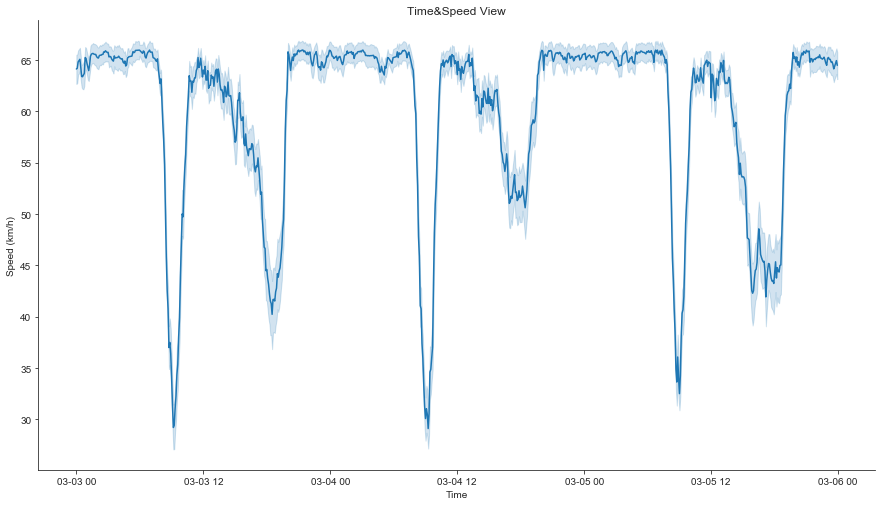

In [114]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(15, 8.27)
#ax.set_xlim((temp.index.min(), temp.index.max()))
ax.set_xlabel('Time')
ax.set_ylabel('Speed (km/h)')
ax.set_title('Time&Speed View')
sns.lineplot(ax=ax, data=temp, x=temp.index.values, y=temp.speed.values, ci=95)
sns.despine()

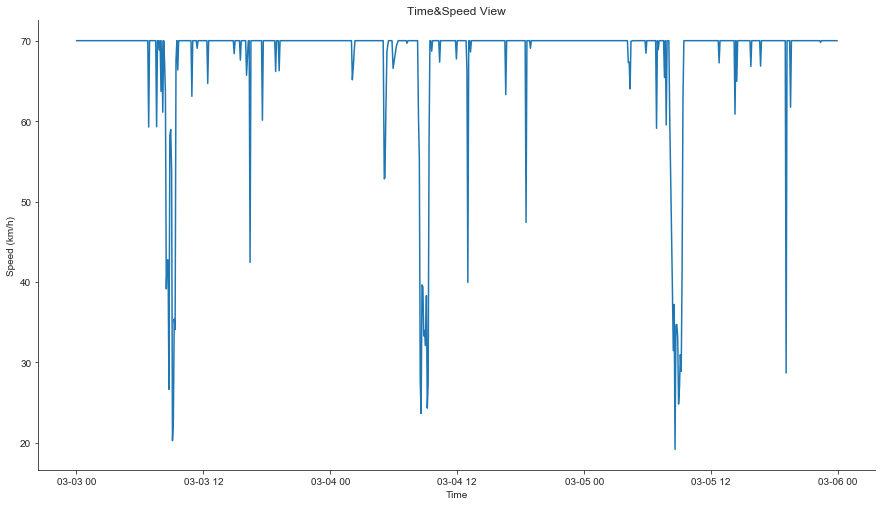

In [115]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(15, 8.27)
#ax.set_xlim((df_segment.index.min(), df_segment.index.max()))
ax.set_xlabel('Time')
ax.set_ylabel('Speed (km/h)')
ax.set_title('Time&Speed View')
sns.lineplot(ci=95, ax=ax, data=df_segment, x=df_segment.index.values, y=df_segment.speed.values)
sns.despine()

In [116]:
#segmentidnew for test
df_corridor['segmentIdNew'] = df_corridor.index.values

counter=-1
for i in df_corridor.segmentId:
    counter = counter +1
    df_test.loc[df_test['segmentId']==i,'segmentIdNew'] = df_corridor['segmentIdNew'][counter]

df_test['segmentIdNew'] = df_test['segmentIdNew'].astype('int64')
df_test['segmentIdNew'] = df_test['segmentIdNew'].astype('category')
df_test

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute,segmentIdNew
0,678443,36117,50,2021-03-15 00:00:00,2600,10,50.008154,1,0,0.0,0
171,678443,36117,50,2021-03-15 14:15:00,2600,10,50.008154,1,14,855.0,0
172,678443,36117,50,2021-03-15 14:20:00,2600,10,50.008154,1,14,860.0,0
173,678443,36117,50,2021-03-15 14:25:00,2600,10,50.008154,1,14,865.0,0
174,678443,36117,50,2021-03-15 14:30:00,2600,10,50.008154,1,14,870.0,0
...,...,...,...,...,...,...,...,...,...,...,...
82409,678982,24223,70,2021-03-15 07:55:00,1245,10,70.042410,1,7,475.0,306
82410,678982,24223,70,2021-03-15 08:00:00,1245,10,70.042410,1,8,480.0,306
82411,678982,24223,70,2021-03-15 08:05:00,1245,10,70.042410,1,8,485.0,306
82397,678982,24223,70,2021-03-15 06:55:00,1245,10,70.042410,1,6,415.0,306


In [117]:
df_corridor['segmentIdNew'] = df_corridor.index.values

counter=-1
for i in df_corridor.segmentId:
    counter = counter +1
    df_conc.loc[df_conc['segmentId']==i,'segmentIdNew'] = df_corridor['segmentIdNew'][counter]

df_conc['segmentIdNew'] = df_conc['segmentIdNew'].astype('int64')
df_conc['segmentIdNew'] = df_conc['segmentIdNew'].astype('category')
df_conc

,segmentId,lengthmm,speedLimitKph,discoveryTime,travelTime,coverage,speed,limitBreak,hour,minute,segmentIdNew
0,678443,36117,50,2021-03-05 00:00:00,2600,10,50.008154,1,0,0.0,0
564,678443,36117,50,2021-03-03 23:20:00,2600,10,50.008154,1,23,1400.0,0
565,678443,36117,50,2021-03-03 23:25:00,2600,10,50.008154,1,23,1405.0,0
566,678443,36117,50,2021-03-03 23:30:00,2600,10,50.008154,1,23,1410.0,0
567,678443,36117,50,2021-03-03 23:35:00,2600,10,50.008154,1,23,1415.0,0
...,...,...,...,...,...,...,...,...,...,...,...
262827,678982,24223,70,2021-03-03 00:05:00,1245,10,70.042410,1,0,5.0,306
262828,678982,24223,70,2021-03-03 00:10:00,1245,10,70.042410,1,0,10.0,306
262829,678982,24223,70,2021-03-03 00:15:00,1245,10,70.042410,1,0,15.0,306
262831,678982,24223,70,2021-03-03 00:25:00,1245,10,70.042410,1,0,25.0,306


In [118]:
df_3dscatter = df_conc[['segmentIdNew','hour','speed']]

In [119]:
df_anomaly = df_conc[['segmentIdNew','speed','discoveryTime']]
df_anomalyy = df_anomaly[['segmentIdNew','speed']]

In [120]:
#test
df_minute_test = df_test[['segmentIdNew','speed','minute']]
df_minute_test
#train
df_minute = df_conc[['segmentIdNew','speed','minute']]
df_minute

,segmentIdNew,speed,minute
0,0,50.008154,0.0
564,0,50.008154,1400.0
565,0,50.008154,1405.0
566,0,50.008154,1410.0
567,0,50.008154,1415.0
...,...,...,...
262827,306,70.042410,5.0
262828,306,70.042410,10.0
262829,306,70.042410,15.0
262831,306,70.042410,25.0


In [121]:
df_minute_test

,segmentIdNew,speed,minute
0,0,50.008154,0.0
171,0,50.008154,855.0
172,0,50.008154,860.0
173,0,50.008154,865.0
174,0,50.008154,870.0
...,...,...,...
82409,306,70.042410,475.0
82410,306,70.042410,480.0
82411,306,70.042410,485.0
82397,306,70.042410,415.0


In [436]:
df_anomaly_seg_minute = df_minute[df_minute['segmentIdNew']==118]
df_anomaly_seg_minute = df_anomaly_seg_minute.drop('segmentIdNew',axis=1)
df_anomaly_seg_minute
#
df_anomaly_seg_minute_test = df_minute_test[df_minute_test['segmentIdNew']==118]
df_anomaly_seg_minute_test = df_anomaly_seg_minute_test.drop('segmentIdNew',axis=1)
df_anomaly_seg_minute_test

,speed,minute
31923,70.027468,905.0
31922,66.147568,900.0
31921,60.731017,895.0
31920,64.069634,890.0
31919,52.633548,885.0
...,...,...
31830,70.027468,440.0
31829,70.027468,435.0
31828,70.027468,430.0
31827,70.027468,425.0


In [123]:
df_anomaly_seg = df_anomaly[df_anomaly['segmentIdNew']==285]
df_anomaly_seg.index = df_anomaly_seg.discoveryTime
df_anomaly_seg = df_anomaly_seg.drop('discoveryTime',axis=1)
df_anomaly_seg

,segmentIdNew,speed
discoveryTime,,
2021-03-03 23:55:00,285,70.044851
2021-03-03 23:50:00,285,70.044851
2021-03-03 23:45:00,285,70.044851
2021-03-03 23:40:00,285,70.044851
2021-03-03 23:15:00,285,70.044851
...,...,...
2021-03-03 00:00:00,285,70.044851
2021-03-03 00:05:00,285,70.044851
2021-03-03 00:10:00,285,70.044851


In [124]:
# DBSCAN

In [125]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_anomaly_seg_minute_scaled = scaler.fit_transform(df_anomaly_seg_minute)
db = DBSCAN(eps=0.06, min_samples=3).fit(df_anomaly_seg_minute_scaled)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
labels

array([ 0,  1,  1,  1,  1,  2,  1,  1,  0,  2,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  1,  0,  1,  1,  1,  0,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  1,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  0,  0,  0,  3,  3,  3,  3,  3,  3,
       -1,  3,  3,  3,  3

In [126]:
df_anomaly_seg_minute['anomaly']=labels
df_anomaly_seg_minute['anomaly'] = df_anomaly_seg_minute['anomaly'].astype('category')

In [127]:
df_anomaly_seg_minute.anomaly.value_counts()

0     511
1     171
3     101
5      61
2       6
-1      5
4       3
Name: anomaly, dtype: int64

In [128]:
toscatter =df_anomaly_seg_minute[df_anomaly_seg_minute['anomaly']== -1]

In [129]:
df_conc[df_conc['segmentIdNew']==285]['segmentId']

245093    134879
245092    134879
245091    134879
245090    134879
245085    134879
           ...  
244808    134879
244809    134879
244810    134879
244811    134879
244801    134879
Name: segmentId, Length: 858, dtype: category
Categories (307, int64): [678443, 678442, 678441, 678400, ..., 5855954, 5855953, 5855963, 678982]

[(0.4044212904941176, 0.5346434904470588, 0.9320019126352941),
 (0.603162067917647, 0.7315274773529412, 0.9995652785372549),
 (0.7867207013568628, 0.8448072103686275, 0.9398103849490196),
 (0.9306685963333333, 0.818876999654902, 0.7591463906980392),
 (0.9673165156666667, 0.6574708288078431, 0.5381601507294118),
 (0.8846434386941177, 0.41001709788235297, 0.32250654924705885)]

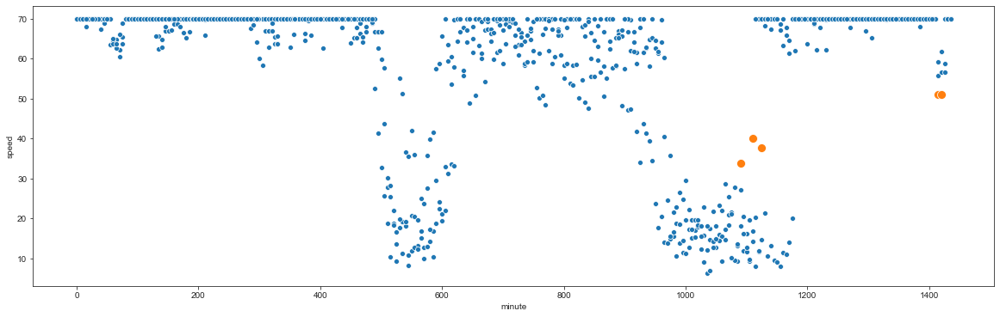

In [130]:
fig, ax = plt.subplots(figsize=(20,6))
#plt.title('-Anomaly- 134879 segmentId', size=15, y=1.05)
sns.scatterplot(df_anomaly_seg_minute.minute, df_anomaly_seg_minute.speed, ax=ax );
sns.scatterplot(toscatter['minute'],toscatter['speed'], ax=ax, s=100, palette=["C0", "C1"]);
sns.color_palette('coolwarm')

In [131]:
#!pip install altair
from altair import *
import altair as alt
import pandas as pd
Chart(df_anomaly_seg_minute,title="This is the Chart Title").mark_point().encode(x='minute',y='speed', color = alt.Color('anomaly', scale=alt. 
                      Scale(scheme = 'set1')))

alt.Chart(...)

Text(0, 0.5, 'Distance')

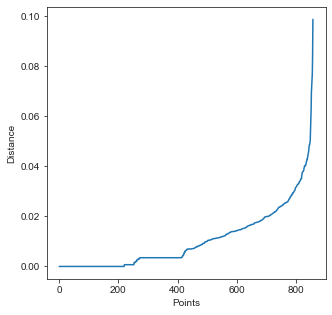

In [132]:
from sklearn.neighbors import NearestNeighbors
nearest_neighbors = NearestNeighbors(n_neighbors=3, metric='euclidean')
neighbors = nearest_neighbors.fit(df_anomaly_seg_minute_scaled)
distances, indices = neighbors.kneighbors(df_anomaly_seg_minute_scaled)
distances = np.sort(distances[:,2], axis=0)
fig = plt.figure(figsize=(5, 5))
plt.plot(distances);
plt.xlabel("Points")
plt.ylabel("Distance")

0.02394995951052568


<Figure size 360x360 with 0 Axes>

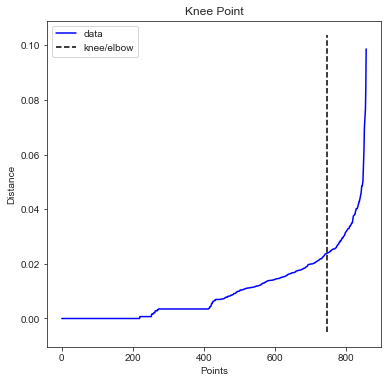

In [133]:
!pip install kneed
from kneed import KneeLocator
i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')
fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")

print(distances[knee.knee])

In [134]:
#test dbscan

In [135]:
df_anomaly_seg_minute_test

,speed,minute
31923,70.027468,905.0
31922,66.147568,900.0
31921,60.731017,895.0
31920,64.069634,890.0
31919,52.633548,885.0
...,...,...
31830,70.027468,440.0
31829,70.027468,435.0
31828,70.027468,430.0
31827,70.027468,425.0


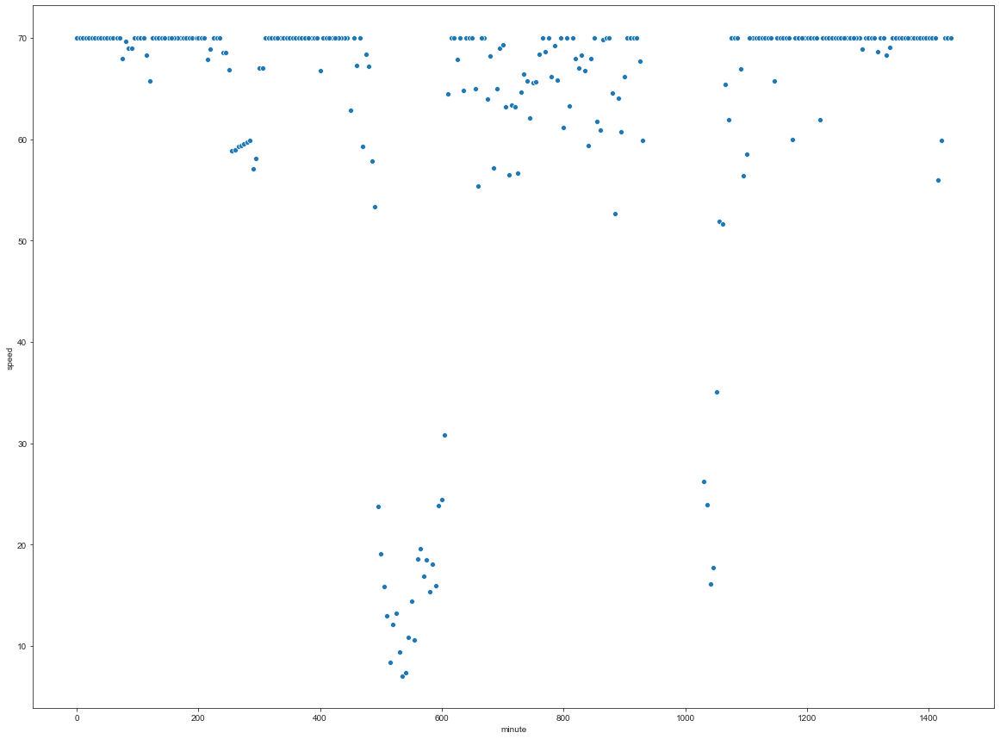

In [136]:
fig, ax = plt.subplots(figsize=(20,15))
sns.scatterplot(df_anomaly_seg_minute_test.minute, df_anomaly_seg_minute_test.speed, ax=ax);
plt.show()

In [137]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_anomaly_seg_minute_test_scaled = scaler.fit_transform(df_anomaly_seg_minute_test)
db = DBSCAN(eps=0.06, min_samples=3).fit(df_anomaly_seg_minute_test_scaled)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
labels

array([ 0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  0,  0,
       -1, -1, -1, -1, -1, -1, -1,  1,  1,  1,  1,  1,  0,  0,  0,  0,  1,
        2,  0,  0,  0,  0,  2,  0,  0,  2,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1, -1, -1,  1,  1,  0,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  0,  1,  2,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  0,  3,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  3,  5,  5,  5,
       -1, -1, -1,  0,  0

In [138]:
df_anomaly_seg_minute_test['anomaly'] = labels
df_anomaly_seg_minute_test['anomaly'] = df_anomaly_seg_minute_test['anomaly'].astype('category')

In [139]:
df_anomaly_seg_minute_test.anomaly.value_counts()

3     86
1     73
0     60
5     19
-1    15
4      9
2      4
6      3
Name: anomaly, dtype: int64

In [140]:
toscatter =df_anomaly_seg_minute_test[df_anomaly_seg_minute_test['anomaly']== -1]

[(0.4044212904941176, 0.5346434904470588, 0.9320019126352941),
 (0.603162067917647, 0.7315274773529412, 0.9995652785372549),
 (0.7867207013568628, 0.8448072103686275, 0.9398103849490196),
 (0.9306685963333333, 0.818876999654902, 0.7591463906980392),
 (0.9673165156666667, 0.6574708288078431, 0.5381601507294118),
 (0.8846434386941177, 0.41001709788235297, 0.32250654924705885)]

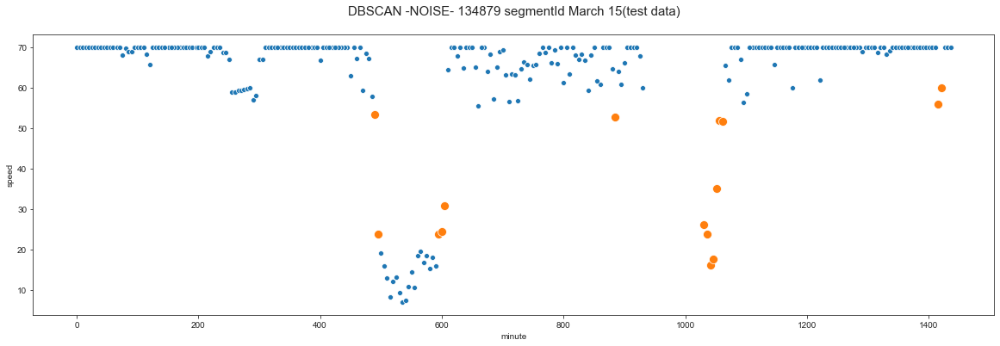

In [141]:
fig, ax = plt.subplots(figsize=(20,6))
plt.title('DBSCAN -NOISE- 134879 segmentId March 15(test data)', size=15, y=1.05)
sns.scatterplot(df_anomaly_seg_minute_test.minute, df_anomaly_seg_minute_test.speed, ax=ax );
sns.scatterplot(toscatter['minute'],toscatter['speed'], ax=ax, s=100, palette=["C0", "C1"]);
sns.color_palette('coolwarm')

In [142]:
altaricin = df_anomaly_seg_minute_test.copy()
altaricin['clusters'] = altaricin.anomaly

In [143]:
#!pip install altair
from altair import *
import altair as alt
import pandas as pd
Chart(altaricin,title='DBSCAN CLUSTERING - 835497 SegmentId - March 15(test data)').mark_point().encode(x='minute',y='speed', color = alt.Color('clusters', scale=alt. 
                      Scale(scheme = 'set1')))

alt.Chart(...)

In [395]:
# K-MEANS

In [396]:
X = df_anomaly_seg_minute.drop('anomaly',axis=1)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)
X

KeyError: "['anomaly'] not found in axis"

In [397]:
'''# CUSTOM X
PLUS = np.array([[-1, -1.5], [-1, -1.6], [-1, -1.7], [-1, -1.8], [-1, -1.9]])
X = np.vstack((X,PLUS))
X'''

'# CUSTOM X\nPLUS = np.array([[-1, -1.5], [-1, -1.6], [-1, -1.7], [-1, -1.8], [-1, -1.9]])\nX = np.vstack((X,PLUS))\nX'

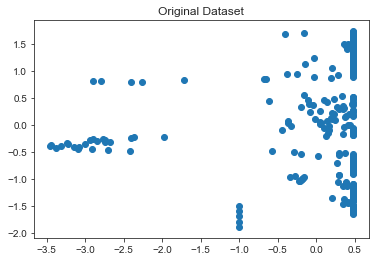

In [398]:
plt.scatter(X[:,0],X[:,1])
plt.title('Original Dataset')
plt.show()

In [399]:
m=X.shape[0]
n=X.shape[1]
counter=0
n_iter=100
tolerance=0.0001
flag=False
K=25

In [400]:
import random
centroids = [X[random.randint(0,m-1)]]
for _ in range(1, K):    
        dist = np.array([min([np.sqrt(np.sum((c-x)**2)) for c in centroids]) for x in X])
        probs = dist/dist.sum()
        centroids.append(X[np.argmax(probs)])
centroids = np.array(centroids).T

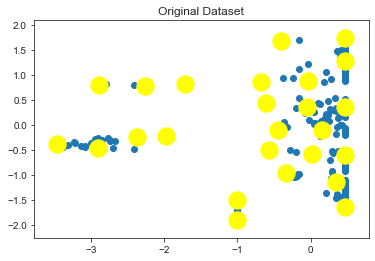

In [401]:
plt.scatter(X[:,0],X[:,1])
plt.title('Original Dataset')
plt.scatter(centroids[0,:],centroids[1,:],s=300,c='yellow')
plt.show()

In [402]:
while (counter < n_iter):
    previous_centroids = list(centroids)
    previous_centroids = np.array(previous_centroids)
    counter += 1
    euclid_dists=np.array([]).reshape(m,0)
    for k in range(K):
        dist=np.sum((X-centroids[:,k])**2,axis=1)
        euclid_dists=np.c_[euclid_dists,dist]
    cmin=np.argmin(euclid_dists,axis=1)+1
    cent={}
    for k in range(K):
        cent[k+1]=np.array([]).reshape(n,0)
    for k in range(m):
        cent[cmin[k]]=np.c_[cent[cmin[k]],X[k]]
    for k in range(K):
        cent[k+1]=cent[k+1].T
    print(counter,". iterasyon",)
    for k in range(K):
        centroids[:,k]=np.mean(cent[k+1],axis=0) 
        diff = np.absolute(centroids[:,k] - previous_centroids[:,k])
        frobenius = np.linalg.norm(diff)
        print(k+1,".centroid frobenius degeri",frobenius)
        if frobenius < tolerance:
            flag = True
    print("***")
            
    final_cent=cent
    if ((flag==True) & (counter>=5)):
        break

1 . iterasyon
1 .centroid frobenius degeri 0.06247596643880416
2 .centroid frobenius degeri 0.11855446786555077
3 .centroid frobenius degeri 0.1304275100683236
4 .centroid frobenius degeri 0.0
5 .centroid frobenius degeri 0.10517504438223492
6 .centroid frobenius degeri 0.09999999999999987
7 .centroid frobenius degeri 0.05251783609555061
8 .centroid frobenius degeri 0.09053565251370224
9 .centroid frobenius degeri 0.11124176416757299
10 .centroid frobenius degeri 0.10740078030631918
11 .centroid frobenius degeri 0.07275946908040637
12 .centroid frobenius degeri 0.12416974909628223
13 .centroid frobenius degeri 0.1250346824504318
14 .centroid frobenius degeri 0.14150139682373977
15 .centroid frobenius degeri 0.10518924568860516
16 .centroid frobenius degeri 0.13689428219664218
17 .centroid frobenius degeri 0.07136845913199581
18 .centroid frobenius degeri 0.09786080744086575
19 .centroid frobenius degeri 0.03446220904167972
20 .centroid frobenius degeri 0.1198004162841948
21 .centroid f

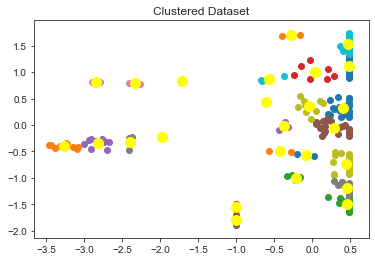

In [403]:
for k in range(K):
    plt.scatter(final_cent[k+1][:,0],final_cent[k+1][:,1])

plt.scatter(centroids[0,:],centroids[1,:],s=100,c='yellow')
plt.title('Clustered Dataset')
plt.show()

In [404]:
#..customize

In [405]:
from sklearn.linear_model import LinearRegression

values_list = []
for k in range(K):
    if(not any((final_cent[k+1][:,0] > 0))):
        x_fit=np.array(final_cent[k+1][:,0]).reshape(-1, 1)
        y_fit=final_cent[k+1][:,0]
        m, b = np.polyfit(final_cent[k+1][:,0], final_cent[k+1][:,1], 1)
        #reg = LinearRegression().fit(x_fit, y_fit)
        m = m - np.trunc(m)
        print(m)
        value = m / (np.absolute(final_cent[k+1][:,0].max()-final_cent[k+1][:,0].min()))**2
        if((value==np.inf) or (value==-np.inf)):
            values_list.append(999999)
        else:
            values_list.append(value)
        #value = reg.coef_ / (np.absolute(final_cent[k+1][:,0].max()-final_cent[k+1][:,0].min()))

    else:
        values_list.append(0)

-0.07578273195714039
-0.2423361387723386
0.7956539860113311
0.8999999999999997
0.11289982562325647
0.4259875074624948
0.30351118360908397
0.04750325803301835
-0.20730371779177234
-0.050385781923316636
-0.08283777449050078
-0.04157208712130496
-0.35804926521219
0.775
0.05631006264924575


C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned



In [406]:
values_list

[0,
 -0.5152135058198646,
 0,
 999999,
 62.164624740801,
 999999,
 10.363831141727722,
 246.18786760327467,
 0,
 3.4350568280822893,
 0,
 0.7719882776041147,
 -6.482479364741659,
 0,
 -0.47921084755235127,
 0,
 -4.093792094348299,
 0,
 0,
 0,
 0,
 -0.5174233235337968,
 999999,
 999999,
 999999]

In [407]:
inds_lane_clusters = []

for i in range(0,len(values_list)):
    if (values_list[i]==999999):
        inds_lane_clusters.append(i+1)
        values_list[i]=0

In [408]:
import statistics

def solution(items):
    average = statistics.mean(items)

    deviations = (abs(item - average) for item in items)
    maxima, index = max((val, idx) for idx, val in enumerate(deviations))

    return index

In [409]:
ind_detect = solution(values_list) +1
#max([3, 7, -10], key=abs)
#ind_detect = np.argmax(values_list)
nearest_anomaly_x_values = final_cent[ind_detect][:,0]
nearest_anomaly_y_values = final_cent[ind_detect][:,1]

m, b = np.polyfit(nearest_anomaly_x_values, nearest_anomaly_y_values, 1)

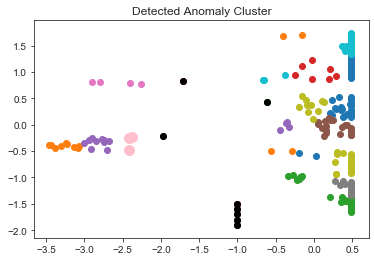

In [410]:
for k in range(K):
    plt.scatter(final_cent[k+1][:,0],final_cent[k+1][:,1])
    
#plt.scatter(centroids[0,:],centroids[1,:],s=75,c='yellow')

for c in inds_lane_clusters:
    plt.scatter(final_cent[c][:,0],final_cent[c][:,1],c='black')
    #plt.plot(final_cent[c][:,0],m*(final_cent[c][:,1])+b,c='black')

plt.scatter(nearest_anomaly_x_values,nearest_anomaly_y_values,s=100,c='pink')
#plt.plot(nearest_anomaly_x_values, m*nearest_anomaly_y_values+b,c='black')
plt.title('Detected Anomaly Cluster')
plt.show()

In [411]:
#test

In [421]:
X = df_anomaly_seg_minute_test.drop('anomaly',axis=1)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)
X

array([[ 2.04233165e-01,  4.84776630e-01],
       [ 2.04233165e-01,  4.72992982e-01],
       [ 1.96317715e-01,  4.61209335e-01],
       [ 2.04233165e-01,  4.49425687e-01],
       [ 2.04233165e-01,  4.37642040e-01],
       [ 2.04233165e-01,  4.25858392e-01],
       [ 2.04233165e-01,  3.90507450e-01],
       [ 2.04233165e-01,  4.02291097e-01],
       [ 2.04233165e-01,  3.78723802e-01],
       [ 2.04233165e-01,  3.66940155e-01],
       [ 2.04233165e-01,  3.55156507e-01],
       [ 2.04233165e-01,  4.96560277e-01],
       [ 2.04233165e-01,  4.14074745e-01],
       [ 2.04233165e-01,  5.08343925e-01],
       [ 2.04233165e-01,  9.23128317e-01],
       [ 2.04233165e-01,  5.31911220e-01],
       [ 2.04233165e-01,  5.43694867e-01],
       [ 2.04233165e-01,  7.81724547e-01],
       [ 2.04233165e-01,  7.93508195e-01],
       [ 2.04233165e-01,  8.05291842e-01],
       [ 2.04233165e-01,  8.17075490e-01],
       [ 2.04233165e-01,  8.28859137e-01],
       [ 2.04233165e-01,  8.40642785e-01],
       [ 2.

In [422]:
# CUSTOM X
PLUS = np.array([[-1, -1.5], [-1, -1.6], [-1, -1.7], [-1, -1.8], [-1, -1.9]])
X = np.vstack((X,PLUS))
X

array([[ 2.04233165e-01,  4.84776630e-01],
       [ 2.04233165e-01,  4.72992982e-01],
       [ 1.96317715e-01,  4.61209335e-01],
       [ 2.04233165e-01,  4.49425687e-01],
       [ 2.04233165e-01,  4.37642040e-01],
       [ 2.04233165e-01,  4.25858392e-01],
       [ 2.04233165e-01,  3.90507450e-01],
       [ 2.04233165e-01,  4.02291097e-01],
       [ 2.04233165e-01,  3.78723802e-01],
       [ 2.04233165e-01,  3.66940155e-01],
       [ 2.04233165e-01,  3.55156507e-01],
       [ 2.04233165e-01,  4.96560277e-01],
       [ 2.04233165e-01,  4.14074745e-01],
       [ 2.04233165e-01,  5.08343925e-01],
       [ 2.04233165e-01,  9.23128317e-01],
       [ 2.04233165e-01,  5.31911220e-01],
       [ 2.04233165e-01,  5.43694867e-01],
       [ 2.04233165e-01,  7.81724547e-01],
       [ 2.04233165e-01,  7.93508195e-01],
       [ 2.04233165e-01,  8.05291842e-01],
       [ 2.04233165e-01,  8.17075490e-01],
       [ 2.04233165e-01,  8.28859137e-01],
       [ 2.04233165e-01,  8.40642785e-01],
       [ 2.

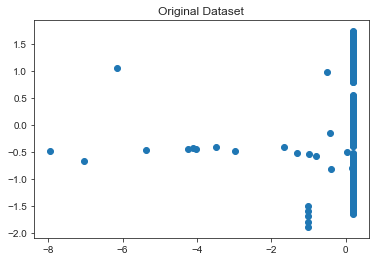

In [423]:
plt.scatter(X[:,0],X[:,1])
plt.title('Original Dataset')
plt.show()

In [424]:
m=X.shape[0]
n=X.shape[1]
counter=0
n_iter=100
tolerance=0.0001
flag=False
K=25

In [425]:
import random
centroids = [X[random.randint(0,m-1)]]
for _ in range(1, K):    
        dist = np.array([min([np.sqrt(np.sum((c-x)**2)) for c in centroids]) for x in X])
        probs = dist/dist.sum()
        centroids.append(X[np.argmax(probs)])
centroids = np.array(centroids).T

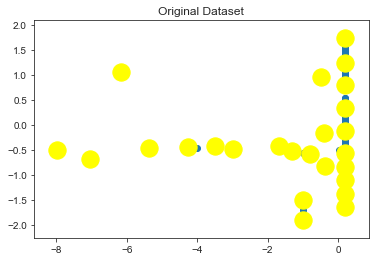

In [426]:
plt.scatter(X[:,0],X[:,1])
plt.title('Original Dataset')
plt.scatter(centroids[0,:],centroids[1,:],s=300,c='yellow')
plt.show()

In [427]:
while (counter < n_iter):
    previous_centroids = list(centroids)
    previous_centroids = np.array(previous_centroids)
    counter += 1
    euclid_dists=np.array([]).reshape(m,0)
    for k in range(K):
        dist=np.sum((X-centroids[:,k])**2,axis=1)
        euclid_dists=np.c_[euclid_dists,dist]
    cmin=np.argmin(euclid_dists,axis=1)+1
    cent={}
    for k in range(K):
        cent[k+1]=np.array([]).reshape(n,0)
    for k in range(m):
        cent[cmin[k]]=np.c_[cent[cmin[k]],X[k]]
    for k in range(K):
        cent[k+1]=cent[k+1].T
    print(counter,". iterasyon",)
    for k in range(K):
        centroids[:,k]=np.mean(cent[k+1],axis=0) 
        diff = np.absolute(centroids[:,k] - previous_centroids[:,k])
        frobenius = np.linalg.norm(diff)
        print(k+1,".centroid frobenius degeri",frobenius)
        if frobenius < tolerance:
            flag = True
    print("***")
            
    final_cent=cent
    if ((flag==True) & (counter>=5)):
        break

1 . iterasyon
1 .centroid frobenius degeri 0.023083863314280695
2 .centroid frobenius degeri 0.0
3 .centroid frobenius degeri 0.0
4 .centroid frobenius degeri 0.09999999999999987
5 .centroid frobenius degeri 0.0
6 .centroid frobenius degeri 0.035388401402112295
7 .centroid frobenius degeri 0.0
8 .centroid frobenius degeri 0.0
9 .centroid frobenius degeri 0.06481006126849875
10 .centroid frobenius degeri 0.0
11 .centroid frobenius degeri 0.011785589293543168
12 .centroid frobenius degeri 0.09563363895311909
13 .centroid frobenius degeri 0.1281430928704772
14 .centroid frobenius degeri 0.0
15 .centroid frobenius degeri 0.0
16 .centroid frobenius degeri 0.00020493300005863802
17 .centroid frobenius degeri 0.0
18 .centroid frobenius degeri 0.11783647503363426
19 .centroid frobenius degeri 0.0
20 .centroid frobenius degeri 0.10251773327926139
21 .centroid frobenius degeri 0.007006493110107981
22 .centroid frobenius degeri 0.050000000000000044
23 .centroid frobenius degeri 0.0
24 .centroid f

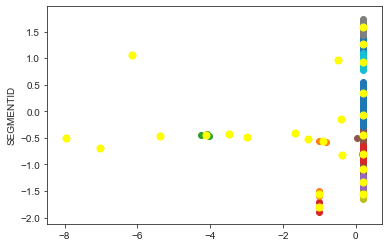

In [428]:
for k in range(K):
    plt.scatter(final_cent[k+1][:,0],final_cent[k+1][:,1])

plt.scatter(centroids[0,:],centroids[1,:],s=50,c='yellow')
plt.ylabel("SEGMENTID")
plt.show()

In [429]:
#customize model

In [430]:
from sklearn.linear_model import LinearRegression

values_list = []
for k in range(K):
    if(not any((final_cent[k+1][:,0] > 0))):
        #x_fit=np.array(final_cent[k+1][:,0]).reshape(-1, 1)
        #y_fit=final_cent[k+1][:,0]
        m, b = np.polyfit(final_cent[k+1][:,0], final_cent[k+1][:,1], 1)
        
        #reg = LinearRegression().fit(x_fit, y_fit)
        m = m - np.trunc(m)
        print(m)
        value = m / (np.absolute(final_cent[k+1][:,0].max()-final_cent[k+1][:,0].min()))**2
        if((value==np.inf) or (value==-np.inf)):
            values_list.append(999999)
        else:
            values_list.append(value)
        #value = reg.coef_ / (np.absolute(final_cent[k+1][:,0].max()-final_cent[k+1][:,0].min()))

    else:
        values_list.append(0)

0.030945484658266593
0.0605305355588701
0.8999999999999997
-0.0855009641106136
0.04373404762794578
0.1228726620488174
0.0484875586059188
-0.1241626984491795
-0.032905447743398646
-0.9752154024187061
0.18612545970341968
0.08075761354167556
0.06633886180272586
0.775
0.20068718479466002


C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RankWarning:

Polyfit may be poorly conditioned

C:\Users\kerem\Anaconda3\lib\site-packages\ipyker

In [431]:
values_list

[0,
 999999,
 999999,
 999999,
 999999,
 0,
 999999,
 999999,
 0,
 999999,
 0,
 -3.4463069151374306,
 -0.6179806761848372,
 999999,
 999999,
 0,
 999999,
 0,
 999999,
 0,
 0,
 999999,
 999999,
 0,
 0]

In [432]:
inds_lane_clusters = []

for i in range(0,len(values_list)):
    if (values_list[i]==999999):
        
        inds_lane_clusters.append(i+1)
        values_list[i]=0

In [433]:
import statistics # dikey çizgi kümeler dışındaki buna en yakın '1' kümeyi alıyoruz

def solution(items):
    average = statistics.mean(items)

    deviations = (abs(item - average) for item in items)
    maxima, index = max((val, idx) for idx, val in enumerate(deviations))

    return index

In [434]:
ind_detect = solution(values_list)+1
#max([3, 7, -10], key=abs)
#ind_detect = np.argmax(values_list)
nearest_anomaly_x_values = final_cent[ind_detect][:,0]
nearest_anomaly_y_values = final_cent[ind_detect][:,1]

m, b = np.polyfit(nearest_anomaly_x_values, nearest_anomaly_y_values, 1)

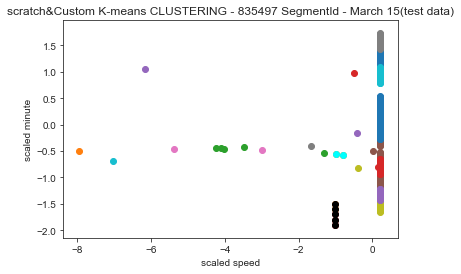

In [435]:
#plt.scatter(centroids[0,:],centroids[1,:],s=75,c='yellow')
#plt.plot(nearest_anomaly_x_values, m*nearest_anomaly_y_values+b,c='black')
for k in range(K):
    plt.scatter(final_cent[k+1][:,0],final_cent[k+1][:,1])
    
#plt.plot(nearest_anomaly_x_values, m*nearest_anomaly_y_values+b,c='black')

for c in inds_lane_clusters:
    if ((len(final_cent[c][:,0]) != 1)):
        #if (final_cent[c][:,0] != final_cent[c][:,1]):
        plt.scatter(final_cent[c][:,0],final_cent[c][:,1],c='black')
        #plt.plot(final_cent[c][:,0],m*(final_cent[c][:,1])+b,c='black')

plt.scatter(nearest_anomaly_x_values,nearest_anomaly_y_values,c='cyan')

#plt.scatter(centroids[0,:],centroids[1,:],s=50,c='yellow')

plt.title('scratch&Custom K-means CLUSTERING - 835497 SegmentId - March 15(test data)')
plt.xlabel("scaled speed")
plt.ylabel("scaled minute")

plt.show()

In [303]:
## AGGLOMERATIVE HIERARCHICAL 

In [304]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_anomaly_seg_minute_scaled = scaler.fit_transform(df_anomaly_seg_minute)
clustering = AgglomerativeClustering(n_clusters = 25).fit(df_anomaly_seg_minute_scaled)
labels =clustering.labels_
labels

array([ 0, 18, 18, 18, 18, 20, 18, 18, 11, 20,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0, 11, 18,  0, 18,  8, 18, 11,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8, 18, 18, 18, 18, 18, 18, 18, 11,
       15,  0,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7, 15, 15, 15,
       15, 15, 15, 15, 15, 15, 15,  8,  7,  0,  7,  7,  0,  0,  0,  0,  0,
        0,  0,  0,  0, 11, 11, 11, 11, 11, 11, 11,  7,  7,  7,  7,  7,  7,
        7, 11,  8,  9,  8, 19,  6, 19,  6,  6,  6, 24,  6,  6,  6,  6,  6,
        6, 24,  6, 24, 24,  6,  6, 24, 24,  6, 24,  6, 17, 22, 19, 15,  9,
        9, 22, 19,  9, 22, 19, 22, 19, 19, 19, 22, 19, 19, 19, 22, 19, 19,
       19, 19, 19, 19,  6,  8, 21, 21, 21, 13, 13, 13, 13, 13, 13, 13, 13,
       21,  1,  1,  1,  1,  1,  1,  1,  1,  1,  8,  1,  8,  8, 13, 21, 13,
       17, 21, 17, 17, 17, 17, 17, 13, 17, 13, 17, 17, 13, 17, 17, 17, 21,
       21, 21, 13, 21, 13, 13, 13, 13, 15,  6, 15, 17, 21, 21, 21, 21, 13,
        3, 21, 17, 13, 17

In [305]:
df_anomaly_seg_minute['anomaly']= labels
df_anomaly_seg_minute['anomaly'] = df_anomaly_seg_minute['anomaly'].astype('category')

In [306]:
df_anomaly_seg_minute.anomaly.value_counts()

2     88
0     79
7     78
8     76
9     62
1     49
18    46
17    41
19    37
6     36
13    35
11    28
22    25
21    25
12    24
4     24
15    22
24    17
16    16
5     16
10    15
20     6
3      6
14     5
23     2
Name: anomaly, dtype: int64

In [181]:
#!pip install altair
from altair import *
import altair as alt
import pandas as pd
Chart(df_anomaly_seg_minute).mark_point().encode(x='minute',y='speed', color = alt.Color('anomaly', scale=alt. 
                      Scale(scheme = 'set1')))

alt.Chart(...)

In [182]:
#test

In [183]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_anomaly_seg_minute_scaled_test = scaler.fit_transform(df_anomaly_seg_minute_test)
clustering = AgglomerativeClustering(n_clusters = 25).fit(df_anomaly_seg_minute_scaled_test)
labels =clustering.labels_
labels

array([ 6,  6, 18,  6, 12,  6,  6,  6, 18, 18,  6,  6,  6,  6,  8,  6, 18,
        0,  0,  0,  0, 21, 12, 12,  8, 13,  8,  8,  8,  6, 11, 20, 11, 13,
       17,  5, 20, 20,  5, 17,  5,  5, 17,  5,  5,  5,  5,  5,  5, 11, 11,
       11, 11, 11, 18, 11, 18, 18,  5, 11,  5, 11, 11, 11, 11, 13, 24,  8,
       24,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 24,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1, 14, 14,  1,  1,  5,  1,  8, 24, 24,
        8,  8,  8,  8,  8,  8,  8, 22, 22, 22, 22, 22, 13, 22, 24, 22, 22,
       22, 22, 22, 22, 13, 24, 24, 24, 24, 24, 24, 24, 24, 22, 20,  1, 17,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
       23, 23, 23, 23, 23, 23, 23, 23, 23, 10, 10, 10, 10,  3, 10,  3,  3,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  3,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  3,  3,  3,  3,  3,  7, 10, 20, 10,
        2, 19,  2,  2, 19, 19, 19, 19,  2, 19,  2,  2,  2, 10,  2,  2,  2,
        4,  4,  4,  5, 20

In [184]:
df_anomaly_seg_minute_test['anomaly']= labels
df_anomaly_seg_minute_test['anomaly'] = df_anomaly_seg_minute_test['anomaly'].astype('category')

In [185]:
df_anomaly_seg_minute_test.anomaly.value_counts()

1     27
3     26
7     25
9     20
5     16
10    15
24    14
8     14
11    13
2     13
22    13
6     12
20    12
23     9
18     7
19     6
13     5
0      4
17     4
4      4
15     3
12     3
14     2
16     1
21     1
Name: anomaly, dtype: int64

In [186]:
#!pip install altair
from altair import *
import altair as alt
import pandas as pd
Chart(df_anomaly_seg_minute_test,title='Agglomerative Clusters 15 March(test data)').mark_point().encode(x='minute',y='speed', color = alt.Color('anomaly', scale=alt. 
                      Scale(scheme = 'set1')))

alt.Chart(...)

In [187]:
######################################

In [188]:
temp_df_ = df_conc[['segmentIdNew','hour','speed']]

_df_0_6 = temp_df_[temp_df_['hour'].between(0,6)]
_df_6_11 = temp_df_[temp_df_['hour'].between(6,11)]
_df_11_14 = temp_df_[temp_df_['hour'].between(11,14)]
_df_14_19 = temp_df_[temp_df_['hour'].between(14,19)]
_df_19_23 = temp_df_[temp_df_['hour'].between(19,23)]

_df_0_6.drop('hour',inplace=True,axis=1)
_df_6_11.drop('hour',inplace=True,axis=1)
_df_11_14.drop('hour',inplace=True,axis=1)
_df_14_19.drop('hour',inplace=True,axis=1)
_df_19_23.drop('hour',inplace=True,axis=1)

C:\Users\kerem\Anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [189]:
_df_14_19

,segmentIdNew,speed
457,0,50.008154
458,0,50.008154
459,0,50.008154
460,0,50.008154
461,0,50.008154
...,...,...
262773,306,70.042410
262774,306,70.042410
262775,306,70.042410
262777,306,70.042410


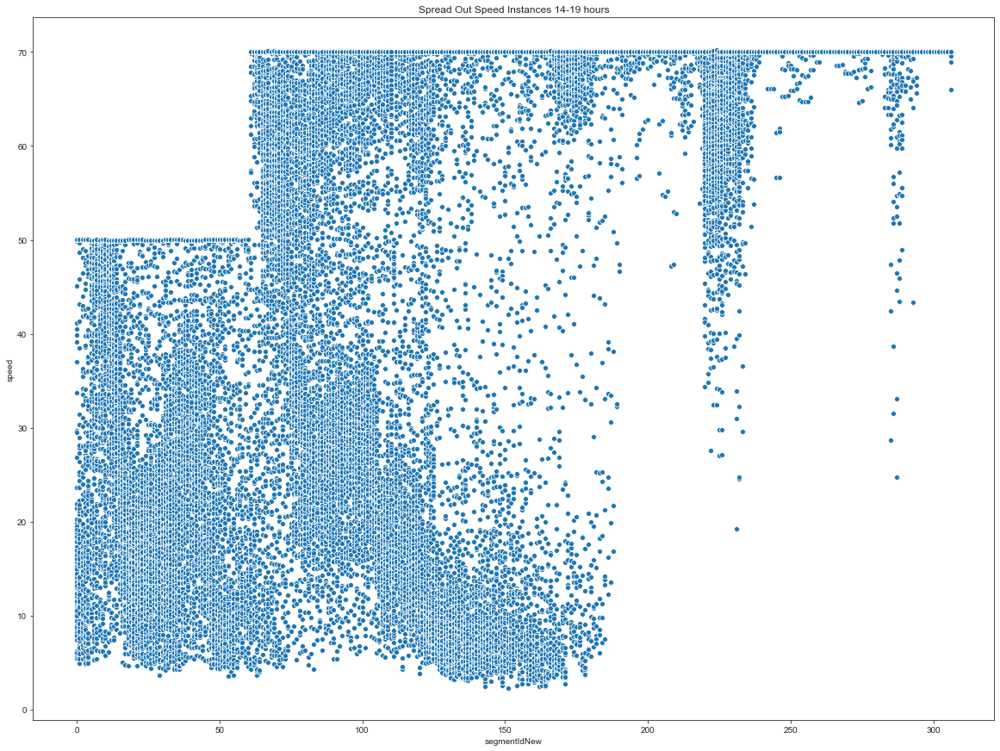

In [190]:
fig, ax = plt.subplots(figsize=(20,15))
sns.scatterplot(_df_14_19.segmentIdNew, _df_14_19.speed, ax=ax, ci=95);
#sns.scatterplot(toscatter['segmentIdNew'],toscatter['speed'], ax=ax, s=100, palette=["C2","C3"]);
sns.color_palette('coolwarm')
#plt.xticks(_df_14_19.segmentIdNew, rotation='vertical')
#ax.set_xticks(_df_14_19.segmentId.values,rotation=45)
#ax.set_xticklabels(_df_14_19.segmentId.values)
plt.title('Spread Out Speed Instances 14-19 hours')
plt.show()
#segment secmek icin kullanicam

In [191]:
##########################

In [192]:
df_3dscatter

,segmentIdNew,hour,speed
0,0,0,50.008154
564,0,23,50.008154
565,0,23,50.008154
566,0,23,50.008154
567,0,23,50.008154
...,...,...,...
262827,306,0,70.042410
262828,306,0,70.042410
262829,306,0,70.042410
262831,306,0,70.042410


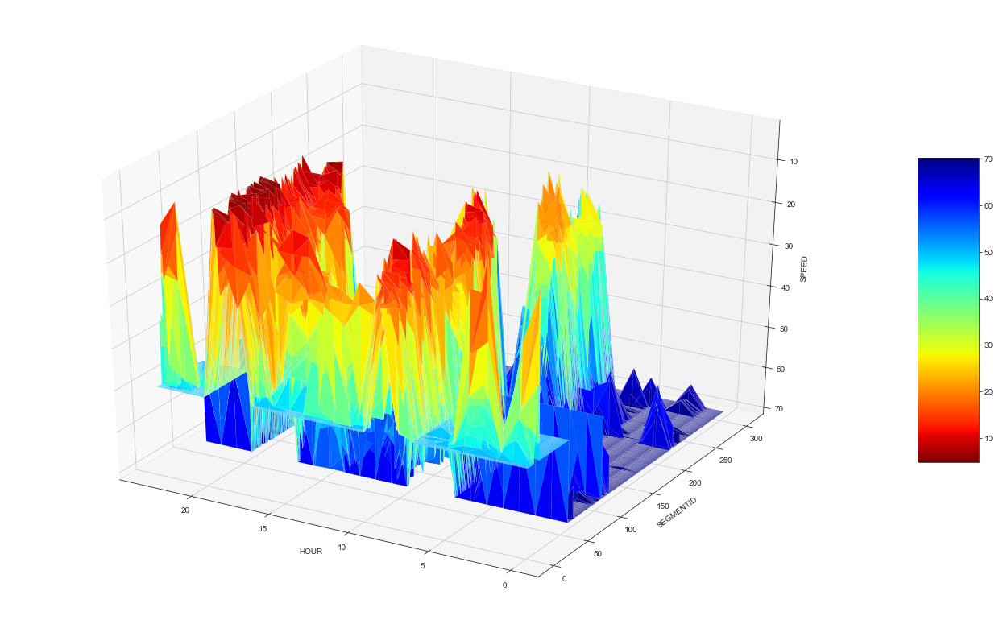

In [193]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sys import argv

x=df_3dscatter.hour.values
y=df_3dscatter.segmentIdNew.values
z=df_3dscatter.speed

fig = plt.figure()
ax = Axes3D(fig)

fig.set_size_inches(18.5, 10.5)

surf = ax.plot_trisurf(x, y, z, cmap=cm.jet.reversed(), linewidth=0.1)
ax.invert_zaxis()
ax.invert_xaxis()

plt.xlabel("HOUR")
plt.ylabel("SEGMENTID")
ax.set_zlabel('SPEED')
#ax.invert_yaxis()
#plt.xticks(df_3dscatter.segmentId.values, rotation='vertical')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

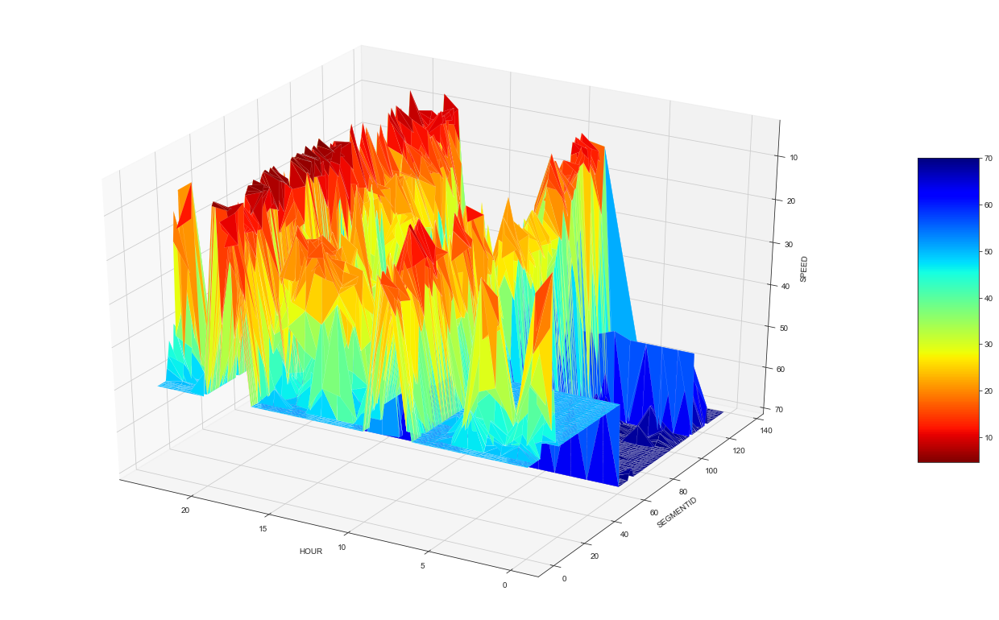

In [194]:
df_3dscatter_ONE = df_3dscatter[:116071]
# ÜSTTEKİ SCATERIN KORIDORUN ILK 3 tebirlik kisimi
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sys import argv

x=df_3dscatter_ONE.hour.values
y=df_3dscatter_ONE.segmentIdNew.values
z=df_3dscatter_ONE.speed

fig = plt.figure()
ax = Axes3D(fig)

fig.set_size_inches(18.5, 10.5)

plt.xlabel("HOUR")
plt.ylabel("SEGMENTID")
ax.set_zlabel('SPEED')


surf = ax.plot_trisurf(x, y, z, cmap=cm.jet.reversed(), linewidth=0.1)
ax.invert_zaxis()
ax.invert_xaxis()
#ax.invert_yaxis()
#plt.xticks(df_3dscatter.segmentId.values, rotation='vertical')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

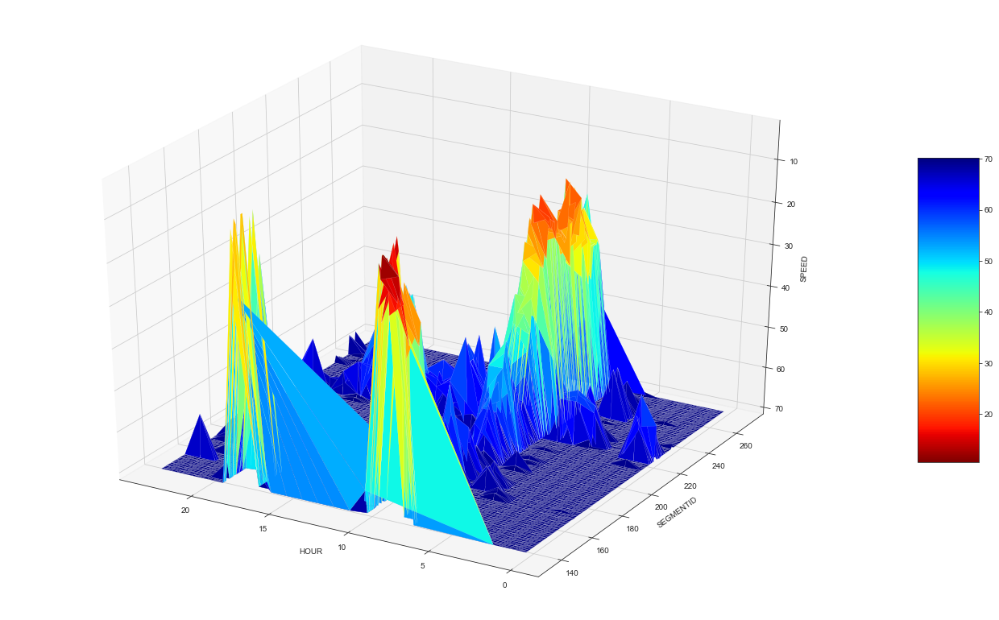

In [195]:
df_3dscatter_TWO = df_3dscatter.loc[116071:116071*2]
# ÜSTTEKİ SCATERIN KORIDORUN ikinci 3 tebirlik kisimi
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sys import argv

x=df_3dscatter_TWO.hour.values
y=df_3dscatter_TWO.segmentIdNew.values
z=df_3dscatter_TWO.speed

fig = plt.figure()
ax = Axes3D(fig)

fig.set_size_inches(18.5, 10.5)

plt.xlabel("HOUR")
plt.ylabel("SEGMENTID")
ax.set_zlabel('SPEED')

surf = ax.plot_trisurf(x, y, z, cmap=cm.jet.reversed(), linewidth=0.1)
ax.invert_zaxis()
ax.invert_xaxis()
#ax.invert_yaxis()
#plt.xticks(df_3dscatter.segmentId.values, rotation='vertical')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

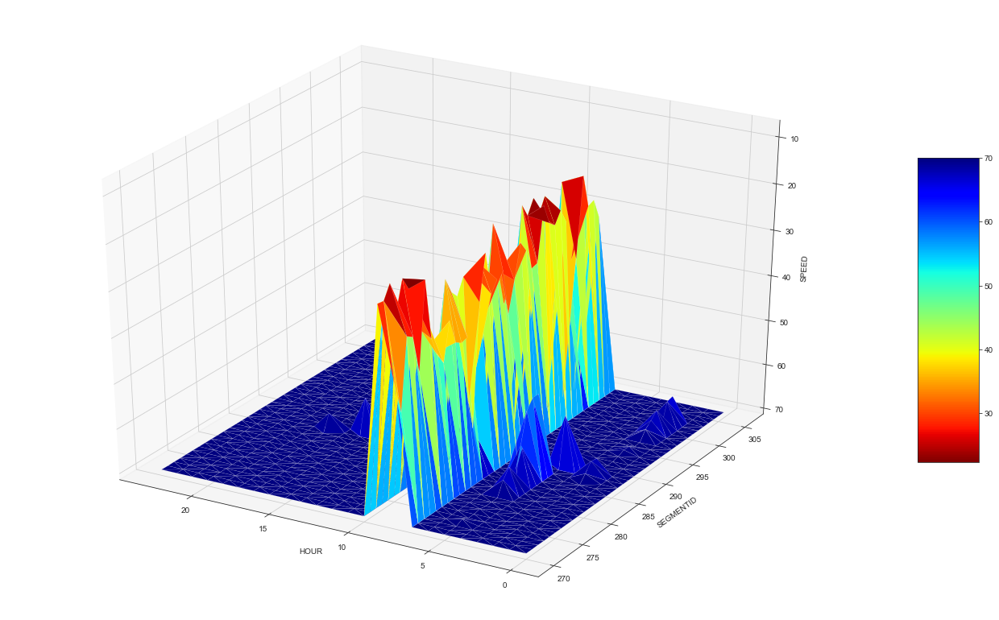

In [196]:
df_3dscatter_THREE = df_3dscatter.loc[116071*2:]
# ÜSTTEKİ SCATERIN KORIDORUN ILK 3 tebirlik kisimi
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sys import argv

x=df_3dscatter_THREE.hour.values
y=df_3dscatter_THREE.segmentIdNew.values
z=df_3dscatter_THREE.speed

fig = plt.figure()
ax = Axes3D(fig)

fig.set_size_inches(18.5, 10.5)
plt.xlabel("HOUR")
plt.ylabel("SEGMENTID")
ax.set_zlabel('SPEED')

surf = ax.plot_trisurf(x, y, z, cmap=cm.jet.reversed(), linewidth=0.1)
ax.invert_zaxis()
ax.invert_xaxis()
#ax.invert_yaxis()
#plt.xticks(df_3dscatter.segmentId.values, rotation='vertical')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

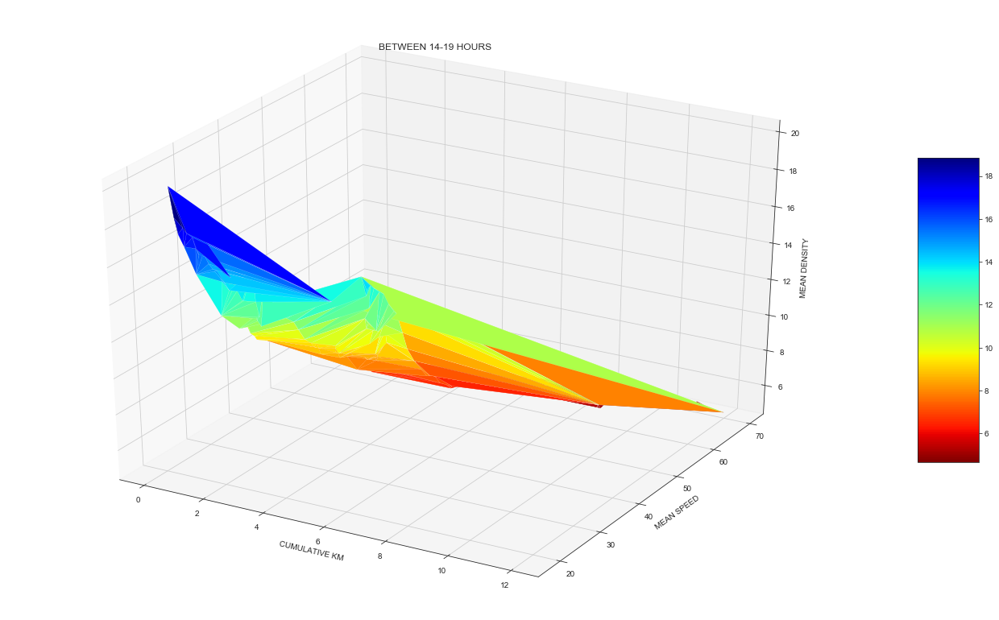

In [197]:
# ID ORDERI DUZELTILECEK
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sys import argv

x=df_corridor.cumLengthKm
y=df_corridor.meanSpeed_14_19.values
z=df_corridor.meanDensity_14_19.values

fig = plt.figure()
ax = Axes3D(fig)

fig.set_size_inches(18.5, 10.5)
plt.title('BETWEEN 14-19 HOURS')
plt.xlabel("CUMULATIVE KM")
plt.ylabel("MEAN SPEED")
ax.set_zlabel('MEAN DENSITY')

surf = ax.plot_trisurf(x, y, z, cmap=cm.jet.reversed(), linewidth=0.1)
#ax.invert_zaxis()
#plt.xticks(df_3dscatter.segmentId.values, rotation='vertical')
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

In [198]:
#3D ANOMALY ANALYSIS
df_3D_anomaly =df_3dscatter.copy()
df_3D_anomaly

,segmentIdNew,hour,speed
0,0,0,50.008154
564,0,23,50.008154
565,0,23,50.008154
566,0,23,50.008154
567,0,23,50.008154
...,...,...,...
262827,306,0,70.042410
262828,306,0,70.042410
262829,306,0,70.042410
262831,306,0,70.042410


In [199]:
'''df_3D_anomaly = df_3D_anomaly.sample(150000)
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_3D_anomaly_scaled = scaler.fit_transform(df_3D_anomaly)
db = DBSCAN(eps=0.5, min_samples=10, n_jobs=-1).fit(df_3D_anomaly_scaled)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
labels'''
# MemoryError:    This has worst case O(n^2) memory complexity. 

'df_3D_anomaly = df_3D_anomaly.sample(150000)\nfrom sklearn.cluster import DBSCAN\nfrom sklearn.preprocessing import MinMaxScaler\nscaler = MinMaxScaler()\ndf_3D_anomaly_scaled = scaler.fit_transform(df_3D_anomaly)\ndb = DBSCAN(eps=0.5, min_samples=10, n_jobs=-1).fit(df_3D_anomaly_scaled)\ncore_samples_mask = np.zeros_like(db.labels_, dtype=bool)\ncore_samples_mask[db.core_sample_indices_] = True\nlabels = db.labels_\nn_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)\nlabels'

In [200]:
from sklearn.cluster import KMeans

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_3D_anomaly_scaled = scaler.fit_transform(df_3D_anomaly)

model_ = KMeans(n_jobs=-1, n_clusters=20, init='k-means++', n_init=10, max_iter=300, tol=0.0001).fit(df_3D_anomaly_scaled)
model_.labels_

array([ 1, 10, 10, ..., 14, 14, 16])

In [201]:
df_3D_anomaly['anomaly'] = pd.Series(model_.labels_, index=df_3D_anomaly.index)
df_3D_anomaly['anomaly'] = df_3D_anomaly['anomaly'].astype('category')

In [202]:
df_3D_anomaly.anomaly.value_counts()

14    22612
3     21871
4     18597
1     17551
17    17183
9     16657
18    16444
11    15265
2     15243
7     15043
16    14757
8     14565
0     14463
10    10791
15     6728
6      6002
5      5404
13     4825
12     4749
19     4646
Name: anomaly, dtype: int64

In [203]:
px.scatter_3d(df_3D_anomaly.sample(100000), x="segmentIdNew", y="hour", z="speed", 
              color="anomaly")

In [204]:
from sklearn.preprocessing import MinMaxScaler
df_3D_anomaly.sample(130000)
scaler = MinMaxScaler()
df_3D_anomaly_scaled = scaler.fit_transform(df_3D_anomaly)

# Elbow Method

score = []

for cluster in range(15,25):
    kmeans = KMeans(n_clusters = cluster, init="k-means++", random_state=10)
    kmeans.fit(df_3D_anomaly_scaled)
    score.append(kmeans.inertia_)

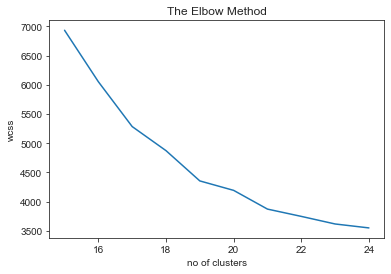

In [205]:
plt.plot(range(15,25), score)
plt.title('The Elbow Method')
plt.xlabel('no of clusters')
plt.ylabel('wcss')
plt.show()

In [206]:
#test
df_3dscatter_test = df_test[['segmentIdNew','hour','speed']]

In [207]:
from sklearn.cluster import KMeans

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_3dscatter_test_scaled = scaler.fit_transform(df_3dscatter_test)

model_ = KMeans(n_jobs=-1, n_clusters=20, init='k-means++', n_init=10, max_iter=300, tol=0.0001).fit(df_3dscatter_test_scaled)
model_.labels_

array([18,  5,  5, ...,  1,  1,  9])

In [208]:
df_3dscatter_test['anomaly'] = pd.Series(model_.labels_, index=df_3dscatter_test.index)
df_3dscatter_test['anomaly'] = df_3dscatter_test['anomaly'].astype('category')

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\kerem\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [209]:
df_anomaly_seg_minute_test.anomaly.value_counts()

1     27
3     26
7     25
9     20
5     16
10    15
24    14
8     14
11    13
2     13
22    13
6     12
20    12
23     9
18     7
19     6
13     5
0      4
17     4
4      4
15     3
12     3
14     2
16     1
21     1
Name: anomaly, dtype: int64

In [210]:
px.scatter_3d(df_3dscatter_test, x="segmentIdNew", y="hour", z="speed", 
              color="anomaly")

In [211]:
### anomaly detection

In [212]:
import platform
platform.python_version()

'3.7.4'

In [214]:
#df_3dscatter = df_3dscatter.drop('anomaly',axis=1)
df_3dscatter_test = df_3dscatter_test.drop('anomaly',axis=1)

In [217]:
df_train_anomaly = df_3dscatter.copy()
df_test_anomaly =df_3dscatter_test.copy()
df_train_anomaly

,segmentIdNew,hour,speed
0,0,0,50.008154
564,0,23,50.008154
565,0,23,50.008154
566,0,23,50.008154
567,0,23,50.008154
...,...,...,...
262827,306,0,70.042410
262828,306,0,70.042410
262829,306,0,70.042410
262831,306,0,70.042410


In [218]:
df_test_anomaly

,segmentIdNew,hour,speed
0,0,0,50.008154
171,0,14,50.008154
172,0,14,50.008154
173,0,14,50.008154
174,0,14,50.008154
...,...,...,...
82409,306,7,70.042410
82410,306,8,70.042410
82411,306,8,70.042410
82397,306,6,70.042410


In [219]:
'''def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), scipy.stats.sem(a)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h'''

'def mean_confidence_interval(data, confidence=0.95):\n    a = 1.0 * np.array(data)\n    n = len(a)\n    m, se = np.mean(a), scipy.stats.sem(a)\n    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)\n    return m, m-h, m+h'

In [220]:
stats = df_train_anomaly.groupby(['segmentIdNew','hour'])['speed'].agg(['mean', 'count', 'std'])
stats
#
stats_test = df_test_anomaly.groupby(['segmentIdNew','hour'])['speed'].agg(['mean', 'count', 'std'])
stats_test

mean  count       std
segmentIdNew hour                            
0            0     50.008154     12  0.000000
             1     50.008154     12  0.000000
             2     50.008154     12  0.000000
             3     50.008154     12  0.000000
             4     50.008154     12  0.000000
...                      ...    ...       ...
306          19    69.437292     12  2.096190
             20    70.042410     12  0.000000
             21    69.422269     12  2.148231
             22    70.042410     12  0.000000
             23    70.042410     12  0.000000

[7061 rows x 3 columns]

In [221]:
ci95_hi = []
ci95_lo = []

for i in stats.index:
    m, c, s = stats.loc[i]
    ci95_hi.append(m + 2.575*s/math.sqrt(c))
    ci95_lo.append(m - 2.575*s/math.sqrt(c))

stats['ci95_hi'] = ci95_hi
stats['ci95_lo'] = ci95_lo
stats
#
ci95_hi = []
ci95_lo = []

for i in stats_test.index:
    m, c, s = stats_test.loc[i]
    ci95_hi.append(m + 2.575*s/math.sqrt(c))
    ci95_lo.append(m - 2.575*s/math.sqrt(c))

stats_test['ci95_hi'] = ci95_hi
stats_test['ci95_lo'] = ci95_lo
stats_test

mean  count       std    ci95_hi    ci95_lo
segmentIdNew hour                                                  
0            0     50.008154     12  0.000000  50.008154  50.008154
             1     50.008154     12  0.000000  50.008154  50.008154
             2     50.008154     12  0.000000  50.008154  50.008154
             3     50.008154     12  0.000000  50.008154  50.008154
             4     50.008154     12  0.000000  50.008154  50.008154
...                      ...    ...       ...        ...        ...
306          19    69.437292     12  2.096190  70.995471  67.879113
             20    70.042410     12  0.000000  70.042410  70.042410
             21    69.422269     12  2.148231  71.019132  67.825406
             22    70.042410     12  0.000000  70.042410  70.042410
             23    70.042410     12  0.000000  70.042410  70.042410

[7061 rows x 5 columns]

In [222]:
stats_resetted = stats.reset_index()
stats_resetted
#
stats_test_resetted = stats_test.reset_index()
stats_test_resetted

,segmentIdNew,hour,mean,count,std,ci95_hi,ci95_lo
0,0,0,50.008154,12,0.000000,50.008154,50.008154
1,0,1,50.008154,12,0.000000,50.008154,50.008154
2,0,2,50.008154,12,0.000000,50.008154,50.008154
3,0,3,50.008154,12,0.000000,50.008154,50.008154
4,0,4,50.008154,12,0.000000,50.008154,50.008154
...,...,...,...,...,...,...,...
7056,306,19,69.437292,12,2.096190,70.995471,67.879113
7057,306,20,70.042410,12,0.000000,70.042410,70.042410
7058,306,21,69.422269,12,2.148231,71.019132,67.825406
7059,306,22,70.042410,12,0.000000,70.042410,70.042410


In [223]:
stats_resetted

,segmentIdNew,hour,mean,count,std,ci95_hi,ci95_lo
0,0,0,50.008154,36,0.000000,50.008154,50.008154
1,0,1,50.008154,36,0.000000,50.008154,50.008154
2,0,2,50.008154,36,0.000000,50.008154,50.008154
3,0,3,50.008154,36,0.000000,50.008154,50.008154
4,0,4,50.008154,37,0.000000,50.008154,50.008154
...,...,...,...,...,...,...,...
7363,306,19,70.042410,36,0.000000,70.042410,70.042410
7364,306,20,70.042410,36,0.000000,70.042410,70.042410
7365,306,21,70.042410,36,0.000000,70.042410,70.042410
7366,306,22,70.033078,36,0.055989,70.057107,70.009049


In [224]:
stats_test_resetted = pd.DataFrame(stats_test_resetted.values.repeat(stats_test_resetted['count'], axis=0), columns=stats_test_resetted.columns)
stats_resetted = pd.DataFrame(stats_resetted.values.repeat(stats_resetted['count'], axis=0), columns=stats_resetted.columns)

In [225]:
stats_resetted['speed'] = df_train_anomaly.groupby(['segmentIdNew','hour'])['speed'].transform(np.absolute)
stats_test_resetted['speed'] = df_test_anomaly.groupby(['segmentIdNew','hour'])['speed'].transform(np.absolute)

In [226]:
stats_test_resetted.drop(['mean','count','std','ci95_hi','ci95_lo'],axis=1,inplace=True)
stats_resetted.drop(['mean','count','std'],axis=1,inplace=True)

In [227]:
stats_resetted

,segmentIdNew,hour,ci95_hi,ci95_lo,speed
0,0.0,0.0,50.008154,50.008154,50.008154
1,0.0,0.0,50.008154,50.008154,50.008154
2,0.0,0.0,50.008154,50.008154,50.008154
3,0.0,0.0,50.008154,50.008154,50.008154
4,0.0,0.0,50.008154,50.008154,50.008154
...,...,...,...,...,...
263391,306.0,23.0,70.140471,69.717296,70.042410
263392,306.0,23.0,70.140471,69.717296,70.042410
263393,306.0,23.0,70.140471,69.717296,70.042410
263394,306.0,23.0,70.140471,69.717296,70.042410


In [228]:
stats_test_resetted

,segmentIdNew,hour,speed
0,0.0,0.0,50.008154
1,0.0,0.0,50.008154
2,0.0,0.0,50.008154
3,0.0,0.0,50.008154
4,0.0,0.0,50.008154
...,...,...,...
82578,306.0,23.0,70.042410
82579,306.0,23.0,70.042410
82580,306.0,23.0,70.042410
82581,306.0,23.0,70.042410


In [229]:
stats_test_resetted['ci95_hi'] = stats_resetted.groupby(['segmentIdNew','hour'])['ci95_hi'].transform(np.absolute)
stats_test_resetted['ci95_lo'] = stats_resetted.groupby(['segmentIdNew','hour'])['ci95_lo'].transform(np.absolute)

In [230]:
stats_test_resetted

,segmentIdNew,hour,speed,ci95_hi,ci95_lo
0,0.0,0.0,50.008154,50.008154,50.008154
1,0.0,0.0,50.008154,50.008154,50.008154
2,0.0,0.0,50.008154,50.008154,50.008154
3,0.0,0.0,50.008154,50.008154,50.008154
4,0.0,0.0,50.008154,50.008154,50.008154
...,...,...,...,...,...
82578,306.0,23.0,70.042410,70.205455,69.174417
82579,306.0,23.0,70.042410,70.205455,69.174417
82580,306.0,23.0,70.042410,70.205455,69.174417
82581,306.0,23.0,70.042410,70.205455,69.174417


In [231]:
stats_test_resetted['anomaly'] = 0
stats_test_resetted.loc[(stats_test_resetted['speed'] <= stats_test_resetted.ci95_hi) & (stats_test_resetted['speed'] >= stats_test_resetted.ci95_lo) ,'anomaly'] = 0
stats_test_resetted.loc[(stats_test_resetted['speed'] > stats_test_resetted.ci95_hi) | (stats_test_resetted['speed'] < stats_test_resetted.ci95_lo) ,'anomaly'] = 1



In [232]:
stats_test_resetted

,segmentIdNew,hour,speed,ci95_hi,ci95_lo,anomaly
0,0.0,0.0,50.008154,50.008154,50.008154,0
1,0.0,0.0,50.008154,50.008154,50.008154,0
2,0.0,0.0,50.008154,50.008154,50.008154,0
3,0.0,0.0,50.008154,50.008154,50.008154,0
4,0.0,0.0,50.008154,50.008154,50.008154,0
...,...,...,...,...,...,...
82578,306.0,23.0,70.042410,70.205455,69.174417,0
82579,306.0,23.0,70.042410,70.205455,69.174417,0
82580,306.0,23.0,70.042410,70.205455,69.174417,0
82581,306.0,23.0,70.042410,70.205455,69.174417,0


In [233]:
stats_test_resetted.anomaly.value_counts()

1    71354
0    11229
Name: anomaly, dtype: int64

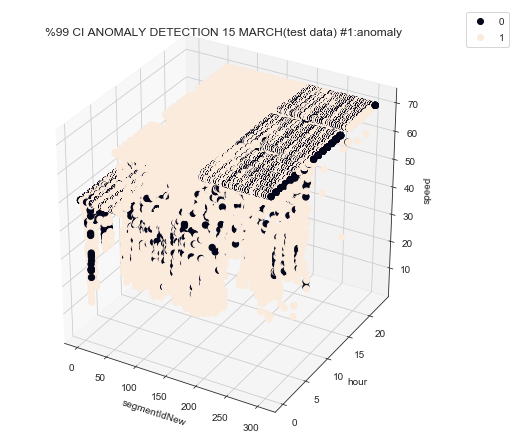

In [238]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap

fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig)

# get colormap from seaborn
cmap = ListedColormap(sns.color_palette("husl", 256).as_hex())

# plot
sc = ax.scatter(stats_test_resetted.segmentIdNew, stats_test_resetted.hour, stats_test_resetted.speed, s=40, c=stats_test_resetted.anomaly, marker='o', alpha=1)
ax.set_xlabel('segmentIdNew')
ax.set_ylabel('hour')
ax.set_zlabel('speed')
plt.title('%99 CI ANOMALY DETECTION 15 MARCH(test data) #1:anomaly')

# legend
plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)

In [241]:
stats_test_resetted

,segmentIdNew,hour,speed,ci95_hi,ci95_lo,anomaly
0,0.0,0.0,50.008154,50.008154,50.008154,0
1,0.0,0.0,50.008154,50.008154,50.008154,0
2,0.0,0.0,50.008154,50.008154,50.008154,0
3,0.0,0.0,50.008154,50.008154,50.008154,0
4,0.0,0.0,50.008154,50.008154,50.008154,0
...,...,...,...,...,...,...
82578,306.0,23.0,70.042410,70.205455,69.174417,0
82579,306.0,23.0,70.042410,70.205455,69.174417,0
82580,306.0,23.0,70.042410,70.205455,69.174417,0
82581,306.0,23.0,70.042410,70.205455,69.174417,0


In [235]:
px.scatter_3d(stats_test_resetted.sample(1000), x="segmentIdNew", y="hour", z="speed", 
              color="anomaly")

[(0.4044212904941176, 0.5346434904470588, 0.9320019126352941),
 (0.603162067917647, 0.7315274773529412, 0.9995652785372549),
 (0.7867207013568628, 0.8448072103686275, 0.9398103849490196),
 (0.9306685963333333, 0.818876999654902, 0.7591463906980392),
 (0.9673165156666667, 0.6574708288078431, 0.5381601507294118),
 (0.8846434386941177, 0.41001709788235297, 0.32250654924705885)]

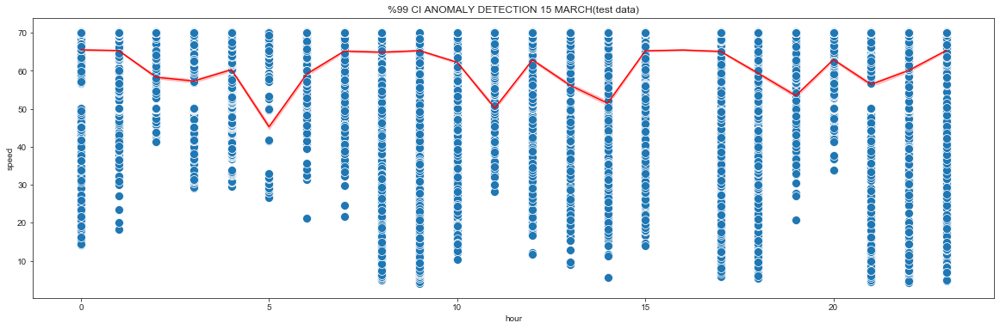

In [466]:
fig, ax = plt.subplots(figsize=(20,6))
plt.title('%99 CI ANOMALY DETECTION 15 MARCH(test data)')
sns.lineplot(stats_resetted.hour, stats_resetted.speed, ax=ax , ci=99, color='red');
sns.scatterplot(stats_test_resetted[stats_test_resetted['anomaly']==1]['hour'],stats_test_resetted[stats_test_resetted['anomaly']==1]['speed'], ax=ax, s=100, palette=["C0", "C1"]);
sns.color_palette('coolwarm')

[(0.4044212904941176, 0.5346434904470588, 0.9320019126352941),
 (0.603162067917647, 0.7315274773529412, 0.9995652785372549),
 (0.7867207013568628, 0.8448072103686275, 0.9398103849490196),
 (0.9306685963333333, 0.818876999654902, 0.7591463906980392),
 (0.9673165156666667, 0.6574708288078431, 0.5381601507294118),
 (0.8846434386941177, 0.41001709788235297, 0.32250654924705885)]

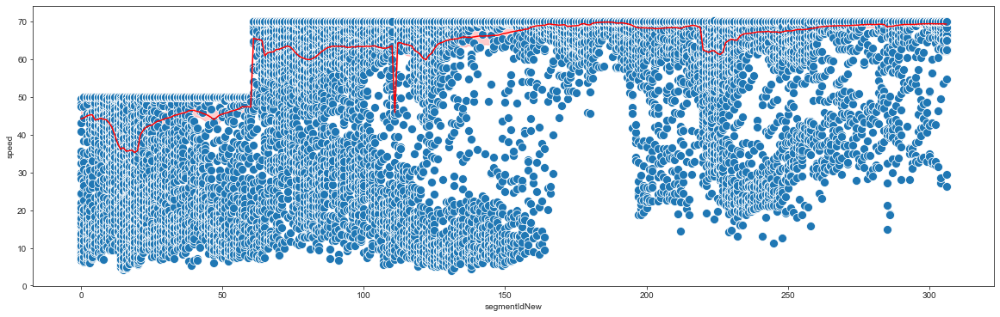

In [237]:
fig, ax = plt.subplots(figsize=(20,6))
sns.lineplot(stats_test_resetted.segmentIdNew, stats_test_resetted.speed, ax=ax , ci=99,color='red');
sns.scatterplot(stats_test_resetted[stats_test_resetted['anomaly']==1]['segmentIdNew'],stats_test_resetted[stats_test_resetted['anomaly']==1]['speed'], ax=ax, s=100, palette=["C0", "C1"]);
sns.color_palette('coolwarm')

In [380]:
#finish

In [ ]:
#value = m / (np.absolute(final_cent[k+1][:,0].max()-final_cent[k+1][:,0].min()))**2
#L = slope / | max - min | ^2

In [459]:
from sklearn.ensemble import IsolationForest
iso = IsolationForest(n_estimators=100,
    max_samples=256,
    max_features=1.0,
    bootstrap=False,
    n_jobs=-1,
    random_state=42,
    verbose=1000,
    contamination=0.005,
    behaviour="new").fit(df_train_anomaly)

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
Building estimator 1 of 25 for this parallel run (total 100)...Building estimator 1 of 25 for this parallel run (total 100)...
Building estimator 1 of 25 for this parallel run (total 100)...
Building estimator 1 of 25 for this parallel run (total 100)...

Building estimator 2 of 25 for this parallel run (total 100)...
Building estimator 2 of 25 for this parallel run (total 100)...
Building estimator 2 of 25 for this parallel run (total 100)...Building estimator 2 of 25 for this parallel run (total 100)...

Building estimator 3 of 25 for this parallel run (total 100)...
Building estimator 3 of 25 for this parallel run (total 100)...
Building estimator 3 of 25 for this parallel run (total 100)...
Building estimator 3 of 25 for this parallel run (total 100)...
Building estimator 4 of 25 for this parallel run (total 100)...
Building estimator 4 of 25 for this parallel run (total 100)...
Building estimator 4 of 

In [461]:
df_test_anomaly = df_test_anomaly.drop('anomaly_isoF',axis=1)

In [462]:
preds_test = iso.predict(df_test_anomaly)
preds_test

array([1, 1, 1, ..., 1, 1, 1])

In [463]:
df_test_anomaly['anomaly_isoF'] = preds_test

In [464]:
df_test_anomaly['anomaly_isoF'].value_counts()

 1    82384
-1      199
Name: anomaly_isoF, dtype: int64

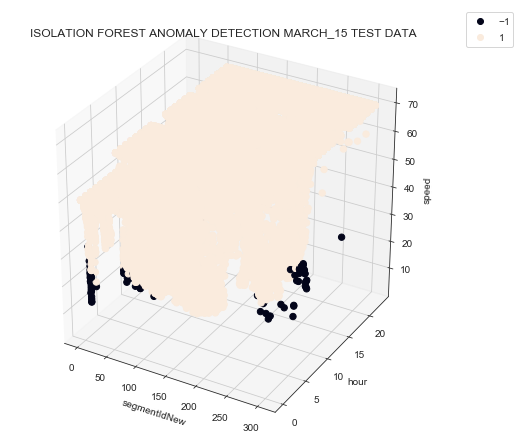

In [465]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap

fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig)

# get colormap from seaborn
cmap = ListedColormap(sns.color_palette("husl", 256).as_hex())

# plot
sc = ax.scatter(df_test_anomaly.segmentIdNew, df_test_anomaly.hour, df_test_anomaly.speed, s=40, c=df_test_anomaly.anomaly_isoF, marker='o', alpha=1)
ax.set_xlabel('segmentIdNew')
ax.set_ylabel('hour')
ax.set_zlabel('speed')
plt.title('ISOLATION FOREST ANOMALY DETECTION MARCH_15 TEST DATA')

# legend
plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)

[(0.4044212904941176, 0.5346434904470588, 0.9320019126352941),
 (0.603162067917647, 0.7315274773529412, 0.9995652785372549),
 (0.7867207013568628, 0.8448072103686275, 0.9398103849490196),
 (0.9306685963333333, 0.818876999654902, 0.7591463906980392),
 (0.9673165156666667, 0.6574708288078431, 0.5381601507294118),
 (0.8846434386941177, 0.41001709788235297, 0.32250654924705885)]

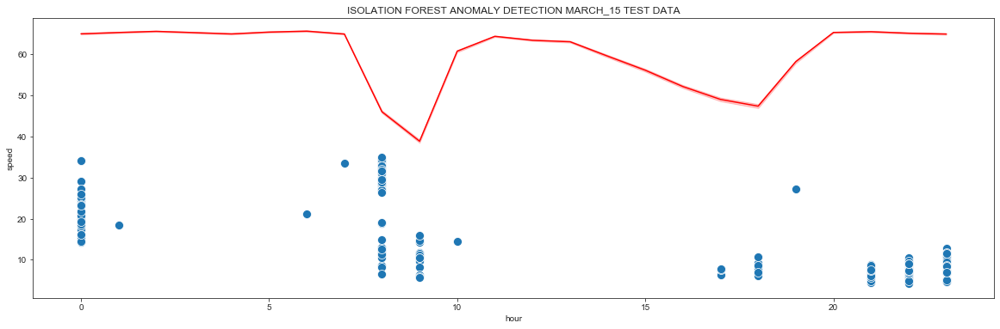

In [468]:
fig, ax = plt.subplots(figsize=(20,6))
plt.title('ISOLATION FOREST ANOMALY DETECTION MARCH_15 TEST DATA')
sns.lineplot(df_train_anomaly.hour, df_train_anomaly.speed, ax=ax, ci=95, color='red');
sns.scatterplot(df_test_anomaly[df_test_anomaly['anomaly_isoF']==-1]['hour'],df_test_anomaly[df_test_anomaly['anomaly_isoF']==-1]['speed'], ax=ax, s=100, palette=["C0", "C1"]);
sns.color_palette('coolwarm')